Experiment 6: Evaluation of extended DiCE genetic framework

Objective: This code runs an experiment comparing the two counterfactual explanation methods (standard genetic DiCE and physics-based constrained DiCE). For each test instance, it generates counterfactuals, computes evaluation metrics (validity, DTW proximity, sparsity, diversity, physics residual, runtime), and aggregates the results into a summary table.

In [105]:
import wandb
import warnings
from sklearn.metrics.pairwise import cosine_similarity
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from dice_ml.explainer_interfaces.explainer_base import UserConfigValidationException
import plotly.graph_objects as go
from datetime import timedelta
import os
import re
import joblib

from scripts.SEP_CFE_DiCE.SEP_CFE_Analyzer import  CFEAnalyzer
from scripts.SEP_CFE_functions import *
min_max_scaler = MinMaxScaler()
warnings.filterwarnings("ignore")

In [ ]:
wandb.init(
    entity="gsu-dmlab",
    project="SEPCFE",  # You choose the project name
    name="Exp6_Evaluation_of_Std_DiCE_vs_Extended_DiCE_and_Visualization",  # Give each run a name
)

In [106]:
abt_path_train = '../data/raw/mean_sliced/train_data.csv'
df_train = pd.read_csv(abt_path_train,  sep=',',index_col=0)
abt_path_test = '../data/raw/mean_sliced/test_data.csv'
df_test = pd.read_csv(abt_path_test, sep=',',index_col=0)
abt_path_val = '../data/raw/mean_sliced/valid_data.csv'
df_val = pd.read_csv(abt_path_val, sep=',',index_col=0)

In [107]:
X_train=pd.read_csv('../data/processed/X_train.csv',sep=',',index_col=0)
Y_train=pd.read_csv('../data/processed/Y_train.csv',sep=',',index_col=0)
X_test=pd.read_csv('../data/processed/X_test.csv',sep=',',index_col=0)
Y_test=pd.read_csv('../data/processed/Y_test.csv',sep=',',index_col=0)
X_val=pd.read_csv('../data/processed/X_val.csv',sep=',',index_col=0)
Y_val=pd.read_csv('../data/processed/Y_val.csv',sep=',',index_col=0)
df_multi_labels = pd.read_excel("../data/raw/multi_labels.xlsx",header=0)
df_multi_labels = df_multi_labels[df_multi_labels['File'] != '1991-06-18_23-16.csv']
df_combined_labels=pd.read_csv('../data/processed/df_combined_labels.csv',sep=',',index_col=0)


In [108]:
# pd.set_option('display.max_columns', None)
# pd.set_option('display.max_rows', None)
# all_entries = os.listdir('../data/raw/data/data/')        # no wildcard here
# csv_files = [f for f in all_entries if f.lower().endswith('.csv')]
# df_combined_labels['not_exists'] = ~df_combined_labels['File'].str.lower().isin(csv_files)
# missing = df_combined_labels[df_combined_labels['not_exists']]
# print(missing[['File', 'not_exists','Label','Event_Y_N']])
# print(df_combined_labels.shape)

# === All Files Are Present (do not run this cell) === #


In [109]:
# Load model
best_rf = joblib.load('../models/RandomForestClassifier_model_sep_cfe.pkl')
Y_pred = best_rf.predict(X_train)
#
# # Output the test classification report and confusion matrix
# print("\nTest Classification Report:\n", classification_report(Y_train, Y_pred))
# print("Test Confusion Matrix:\n", confusion_matrix(Y_train, Y_pred))

**Counterfactual Explainations for SEP Prediction**

In [110]:
df_cfe = df_test.drop(["Label"],axis=1)
#df_cfe = df_combined_labels.drop(["Label","File","Label.1"],axis=1)  # should contain the target column
cont_features = list(df_combined_labels.drop(["Label","Event_Y_N","File","Multi_Label"],axis=1).columns) #should not contain target column

In [111]:
exp_random = joblib.load("../models/sep_cfe_random_explainer.pkl")
exp_genetic = joblib.load("../models/sep_cfe_genetic_explainer.pkl")

In [112]:
feature_names = X_train.columns
k=50
sorted_normalized_weights_df  = get_feature_importance(best_rf,feature_names)
top_k_features = sorted_normalized_weights_df['Feature'].head(k).to_list()
top_k_normalized_weights_dict = sorted_normalized_weights_df.head(k).set_index('Feature')['Normalized Importance'].to_dict()



{'p3_flux_ic_mean@[345:351]': 0.016813218692665152, 'p3_flux_ic_mean@[294:306]': 0.015512243536081334, 'p3_flux_ic_mean@[180:360]': 0.013845563113781103, 'p3_flux_ic_mean@[336:342]': 0.013481700224440563, 'p3_flux_ic_mean@[336:359]': 0.011833220526009637, 'p3_flux_ic_mean@[306:312]': 0.011426146862369903, 'p3_flux_ic_mean@[336:348]': 0.010816571712953495, 'p3_flux_ic_mean@[354:360]': 0.01034312660313399, 'p3_flux_ic_mean@[300:323]': 0.00973025424545855, 'long_mean@[324:336]': 0.009371275130185179, 'long_mean@[324:347]': 0.009296114622546139, 'p3_flux_ic_mean@[342:348]': 0.009174061176106618, 'p3_flux_ic_mean@[351:357]': 0.00912556869425928, 'p3_flux_ic_mean@[204:216]': 0.009033125189585219, 'p3_flux_ic_mean@[324:347]': 0.008997399971114345, 'p3_flux_ic_mean@[327:333]': 0.008828405668376296, 'p3_flux_ic_mean@[348:360]': 0.008497467075116196, 'p3_flux_ic_mean@[306:318]': 0.0076592971140325575, 'p3_flux_ic_mean@[324:330]': 0.007370584572652872, 'p3_flux_ic_mean@[204:227]': 0.0073415306547

In [113]:
p3_flux_cols = [col for col in df_train.columns if 'p3_flux_ic_mean' in col]
p5_flux_cols = [col for col in df_train.columns if 'p5_flux_ic_mean' in col]
p7_flux_cols = [col for col in df_train.columns if 'p7_flux_ic_mean' in col]


In [115]:
pattern = r'^(p3_flux_ic_mean|p5_flux_ic_mean|p7_flux_ic_mean|long_mean)@\[(\d+:\d+)\]$'
header_list = df_train.columns.astype(str).str.cat(sep="\t").split()
slices = extract_slices_from_headers(header_list,pattern,"p3_flux_ic_mean")


[(0, 6),
 (0, 12),
 (0, 23),
 (0, 45),
 (0, 90),
 (0, 180),
 (0, 360),
 (3, 9),
 (6, 12),
 (6, 18),
 (9, 15),
 (12, 18),
 (12, 24),
 (12, 35),
 (15, 21),
 (18, 24),
 (18, 30),
 (21, 27),
 (23, 68),
 (24, 30),
 (24, 36),
 (24, 47),
 (27, 33),
 (30, 36),
 (30, 42),
 (33, 39),
 (36, 42),
 (36, 48),
 (36, 59),
 (39, 45),
 (42, 48),
 (42, 54),
 (45, 51),
 (45, 135),
 (46, 91),
 (48, 54),
 (48, 60),
 (48, 71),
 (51, 57),
 (54, 60),
 (54, 66),
 (57, 63),
 (60, 66),
 (60, 72),
 (60, 83),
 (63, 69),
 (66, 72),
 (66, 78),
 (69, 75),
 (69, 114),
 (72, 78),
 (72, 84),
 (72, 95),
 (75, 81),
 (78, 84),
 (78, 90),
 (81, 87),
 (84, 90),
 (84, 96),
 (84, 107),
 (87, 93),
 (90, 96),
 (90, 102),
 (90, 180),
 (90, 270),
 (92, 137),
 (93, 99),
 (96, 102),
 (96, 108),
 (96, 119),
 (99, 105),
 (102, 108),
 (102, 114),
 (105, 111),
 (108, 114),
 (108, 120),
 (108, 131),
 (111, 117),
 (114, 120),
 (114, 126),
 (115, 160),
 (117, 123),
 (120, 126),
 (120, 132),
 (120, 143),
 (123, 129),
 (126, 132),
 (126, 138)

Experiment 1

In [116]:
query_ts1_filename = '2003-07-05_23-06.csv'
query_instance1, target_val1,predicted_val= get_query_instance(query_ts1_filename, df_combined_labels=df_combined_labels, model=best_rf)
print(query_instance1)
#print("target value:", target_val1)


Target value for the query instance:
 0.0
Predicted value:
 [0]
      p3_flux_ic_mean@[0:360]  p5_flux_ic_mean@[0:360]  \
2018                 0.124524                 0.052985   

      p7_flux_ic_mean@[0:360]  long_mean@[0:360]  p3_flux_ic_mean@[0:180]  \
2018                 0.028497           0.000002                 0.137702   

      p5_flux_ic_mean@[0:180]  p7_flux_ic_mean@[0:180]  long_mean@[0:180]  \
2018                 0.059212                 0.030233           0.000002   

      p3_flux_ic_mean@[90:270]  p5_flux_ic_mean@[90:270]  ...  \
2018                  0.123492                  0.053115  ...   

      p7_flux_ic_mean@[348:354]  long_mean@[348:354]  \
2018                    0.02234             0.000002   

      p3_flux_ic_mean@[351:357]  p5_flux_ic_mean@[351:357]  \
2018                    0.10355                     0.0428   

      p7_flux_ic_mean@[351:357]  long_mean@[351:357]  \
2018                     0.0292             0.000002   

      p3_flux_ic_mean@[354:

Creating Filtered Dictionary for min-max range

In [117]:
csv_path = os.path.join('../data/raw/data/', query_ts1_filename)
filtered_dict_1 = extract_feature_ranges(csv_path,delim=',', slices=slices, top_k_features=top_k_features,flux_types = ['p3_flux_ic','p5_flux_ic','p7_flux_ic'])
print(filtered_dict_1)

{'p3_flux_ic_mean@[180:360]': [0.0589, 0.227], 'p3_flux_ic_mean@[204:216]': [0.0726, 0.137], 'p3_flux_ic_mean@[204:227]': [0.0726, 0.2122], 'p3_flux_ic_mean@[216:239]': [0.0855, 0.214], 'p3_flux_ic_mean@[222:228]': [0.16604, 0.2128], 'p3_flux_ic_mean@[225:315]': [0.0752, 0.224], 'p3_flux_ic_mean@[230:275]': [0.0752, 0.224], 'p3_flux_ic_mean@[270:360]': [0.0791, 0.227], 'p3_flux_ic_mean@[276:282]': [0.08774, 0.1148], 'p3_flux_ic_mean@[288:294]': [0.11688, 0.204], 'p3_flux_ic_mean@[294:306]': [0.0951, 0.152], 'p3_flux_ic_mean@[299:344]': [0.0863, 0.21], 'p3_flux_ic_mean@[300:306]': [0.1397999999999999, 0.1508], 'p3_flux_ic_mean@[300:323]': [0.0863, 0.154], 'p3_flux_ic_mean@[306:312]': [0.115, 0.1336], 'p3_flux_ic_mean@[306:318]': [0.11338, 0.154], 'p3_flux_ic_mean@[312:324]': [0.0863, 0.154], 'p3_flux_ic_mean@[312:335]': [0.0863, 0.154], 'p3_flux_ic_mean@[318:324]': [0.0863, 0.09984], 'p3_flux_ic_mean@[321:327]': [0.0902599999999999, 0.1157199999999999], 'p3_flux_ic_mean@[324:330]': [0.0

In [119]:
from dice_ml.explainer_interfaces.dice_genetic import DiceGenetic
import numpy as np

class ConstrainedDiceGenetic(DiceGenetic):
    def __init__(self, data_interface, model_interface,
                 permitted_range_dict, ordering_penalty=1e4, **kwargs):
        super().__init__(data_interface, model_interface, **kwargs)
        self.permitted_range_dict = permitted_range_dict
        self.ordering_penalty = ordering_penalty

        # Identify all windows from the permitted_range_dict
        self.windows = []
        for fname in permitted_range_dict:
            if fname.startswith('p3_flux_ic_mean@'):
                window = fname.split('@')[1]
                self.windows.append(window)

        # Build feature name mapping for each window
        self.feature_triplets = []
        for window in self.windows:
            p3 = f'p3_flux_ic_mean@{window}'
            p5 = f'p5_flux_ic_mean@{window}'
            p7 = f'p7_flux_ic_mean@{window}'
            if (p3 in data_interface.feature_names and
                p5 in data_interface.feature_names and
                p7 in data_interface.feature_names):
                self.feature_triplets.append((p3, p5, p7))

        # Build index mapping for fast access
        self.feature_indices = []
        for p3, p5, p7 in self.feature_triplets:
            idx3 = data_interface.feature_names.index(p3)
            idx5 = data_interface.feature_names.index(p5)
            idx7 = data_interface.feature_names.index(p7)
            self.feature_indices.append((idx3, idx5, idx7))

    def _ordering_constraint_penalty(self, candidates):
        """
        Returns a penalty array: 0 if p3 > p5 > p7 for ALL windows, else large penalty.
        """
        penalty = np.zeros(candidates.shape[0])
        for idx3, idx5, idx7 in self.feature_indices:
            p3 = candidates[:, idx3]
            p5 = candidates[:, idx5]
            p7 = candidates[:, idx7]
            violations = (p3 >= 10) | (p3 <= p5) | (p5 <= p7)
            penalty += violations.astype(float) * self.ordering_penalty
        return penalty

    def _range_constraint_penalty(self, candidates):
        """
        Returns penalty if any value is out of permitted range for any feature.
        """
        penalty = np.zeros(candidates.shape[0])
        for fname, (fmin, fmax) in self.permitted_range_dict.items():
            if fname in self.data_interface.feature_names:
                idx = self.data_interface.feature_names.index(fname)
                vals = candidates[:, idx]
                out_of_bounds = (vals < fmin) | (vals > fmax)
                penalty += out_of_bounds.astype(float) * self.ordering_penalty
        return penalty

    def _fitness_fn(self, candidates, query_instance, desired_class, **kwargs):
        """
        Override the fitness function to include ordering and range penalties.
        """
        # Original fitness (lower is better)
        fitness = super()._fitness_fn(candidates, query_instance, desired_class, **kwargs)
        # Add ordering constraint penalty
        fitness += self._ordering_constraint_penalty(candidates)
        # Add range constraint penalty
        fitness += self._range_constraint_penalty(candidates)
        return fitness


In [120]:
import dice_ml
df_train["Event_Y_N"] = df_train['Label'].replace({0:1, -1:0})
cont_features = list(df_train.drop(["Label","Event_Y_N"],axis=1).columns)

df_cfe = df_train.drop("Label",axis=1)
data= dice_ml.Data(dataframe=df_cfe, continuous_features=cont_features, outcome_name='Event_Y_N')
cfe_model = dice_ml.Model(model=best_rf, backend="sklearn", model_type='classifier')
#Create the Dice explainer
Orig_DiCE_exp = dice_ml.Dice(data_interface=data, model_interface=cfe_model, method="genetic") #method= ["genetic","kdtree","random"]

Experiment 1:  testing for ordering penalty 10

In [121]:
#Physics-guided counterfactual explainer based on DiCE
PGC_explainer_exp1 = ConstrainedDiceGenetic(
    data_interface=data,
    model_interface=cfe_model,
    permitted_range_dict=filtered_dict_1,
    ordering_penalty=10

)
# Generate physics-guided counterfactuals
pg_cf_exp1 = PGC_explainer_exp1.generate_counterfactuals(
    query_instances=query_instance1,
    total_CFs=10,
    desired_class=1
)


In [123]:
df_cfe_exp1 = pg_cf_exp1.cf_examples_list[0].final_cfs_df
pg_cf_exp1.cf_examples_list[0].final_cfs_df

,p3_flux_ic_mean@[0:360],p5_flux_ic_mean@[0:360],p7_flux_ic_mean@[0:360],long_mean@[0:360],p3_flux_ic_mean@[0:180],p5_flux_ic_mean@[0:180],p7_flux_ic_mean@[0:180],long_mean@[0:180],p3_flux_ic_mean@[90:270],p5_flux_ic_mean@[90:270],...,long_mean@[348:354],p3_flux_ic_mean@[351:357],p5_flux_ic_mean@[351:357],p7_flux_ic_mean@[351:357],long_mean@[351:357],p3_flux_ic_mean@[354:360],p5_flux_ic_mean@[354:360],p7_flux_ic_mean@[354:360],long_mean@[354:360],Event_Y_N
0,0.067124,0.024,0.0143,0.000005,0.066948,0.023,0.0138,2.577220e-06,0.066845,0.026,...,0.000008,0.0654,0.021,0.0096,0.000008,0.061000,0.019,0.0085,0.000007,1
0,0.067124,0.024,0.0143,0.000005,0.066948,0.023,0.0138,1.042100e-07,0.066845,0.026,...,0.000008,0.0654,0.021,0.0096,0.000008,0.061000,0.013,0.0061,0.000007,1
0,0.075484,0.025,0.0132,0.000001,0.102509,0.024,0.0146,2.536900e-06,0.062344,0.019,...,0.000001,0.1198,0.023,0.0114,0.000001,0.121797,0.025,0.0173,0.000001,1
0,0.283040,0.052,0.0248,0.000001,0.224144,0.051,0.0226,1.205420e-06,0.298694,0.051,...,0.000001,0.4291,0.036,0.0181,0.000001,0.537967,0.035,0.0160,0.000001,1


In [129]:

df_cfe_exp1

# pg_cfe_exp = []
# cfe_df = pg_cf.cf_examples_list[0].final_cfs_df
# pg_cfe_exp.append(cfe_df)  # Append each DataFrame
#
# # Concatenate once after the loop
# df_cfe_exp1 = pd.concat(pg_cfe_exp, ignore_index=True)
# df_cfe_exp1


,p3_flux_ic_mean@[0:360],p5_flux_ic_mean@[0:360],p7_flux_ic_mean@[0:360],long_mean@[0:360],p3_flux_ic_mean@[0:180],p5_flux_ic_mean@[0:180],p7_flux_ic_mean@[0:180],long_mean@[0:180],p3_flux_ic_mean@[90:270],p5_flux_ic_mean@[90:270],...,long_mean@[348:354],p3_flux_ic_mean@[351:357],p5_flux_ic_mean@[351:357],p7_flux_ic_mean@[351:357],long_mean@[351:357],p3_flux_ic_mean@[354:360],p5_flux_ic_mean@[354:360],p7_flux_ic_mean@[354:360],long_mean@[354:360],Event_Y_N
0,0.067124,0.024,0.0143,0.000005,0.066948,0.023,0.0138,0.000003,0.066845,0.026,...,0.000008,0.0654,0.021,0.0096,0.000008,0.061000,0.019,0.0085,0.000007,1
1,3.360161,0.263,0.0457,0.000002,3.156811,0.258,0.0416,0.000002,3.499233,0.270,...,0.000002,2.9137,0.288,0.0704,0.000002,2.939000,0.281,0.0534,0.000002,1
2,4.115570,0.166,0.0224,0.000002,2.683472,0.157,0.0204,0.000002,3.926167,0.176,...,0.000001,7.3587,0.203,0.0369,0.000001,7.754667,0.224,0.0347,0.000001,1
3,0.423076,0.082,0.0389,0.000002,0.421692,0.077,0.0398,0.000001,0.410275,0.087,...,0.000002,0.2224,0.125,0.0432,0.000002,0.221467,0.125,0.0450,0.000002,1
4,0.339046,0.097,0.0390,0.000004,0.247614,0.049,0.0232,0.000001,0.241885,0.057,...,0.000002,2.4587,0.702,0.1727,0.000002,2.959667,0.670,0.1413,0.000002,1
5,1.750250,0.071,0.0275,0.000003,1.885000,0.072,0.0291,0.000002,1.787056,0.068,...,0.000002,1.4073,0.093,0.0261,0.000002,1.350333,0.095,0.0275,0.000002,1
6,0.453315,0.063,0.0296,0.000004,0.457956,0.051,0.0255,0.000002,0.352864,0.058,...,0.000002,0.5834,0.060,0.0367,0.000002,0.707033,0.085,0.0374,0.000002,1
7,0.460889,0.038,0.0182,0.000002,0.429244,0.039,0.0185,0.000001,0.430753,0.036,...,0.000003,0.5636,0.020,0.0098,0.000003,0.447200,0.020,0.0098,0.000003,1
8,2.828885,0.271,0.0882,0.000002,1.274989,0.188,0.0700,0.000001,2.083333,0.220,...,0.000001,6.5455,0.457,0.1388,0.000001,6.623071,0.456,0.1381,0.000001,1
9,0.283040,0.052,0.0248,0.000001,0.224144,0.051,0.0226,0.000001,0.298694,0.051,...,0.000001,0.4291,0.036,0.0181,0.000001,0.537967,0.035,0.0160,0.000001,1


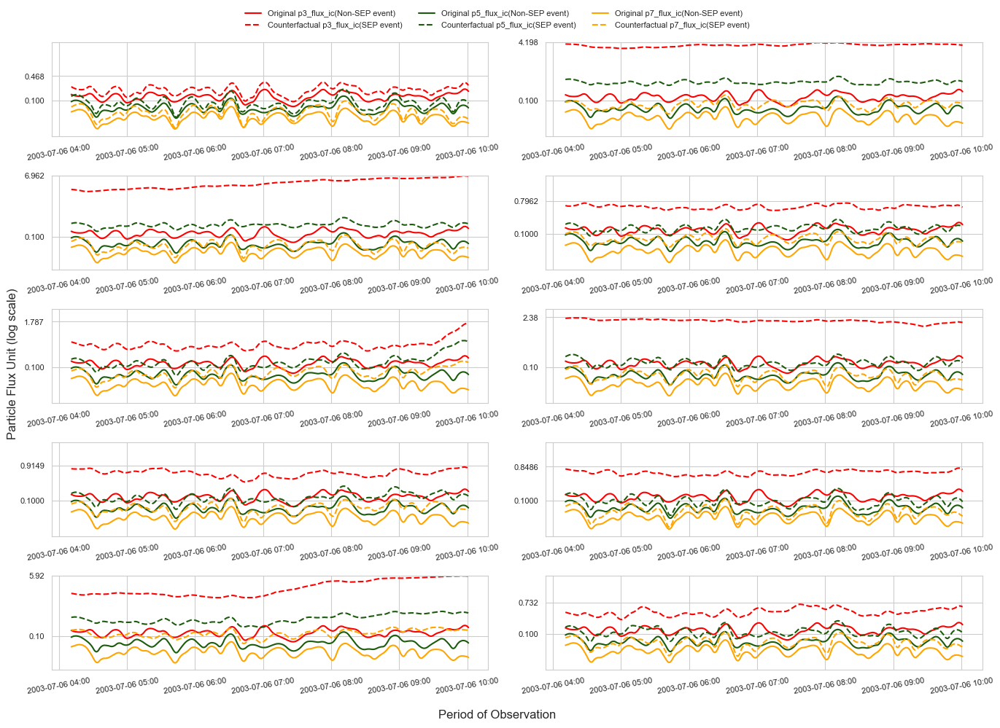

In [134]:
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.dates as mdates

window_size = 10  # Smoothing window

fig, axs = plt.subplots(5, 2, figsize=(14, 10), facecolor='white')
axs = axs.flatten()  # Flatten for easy iteration

for cfe_idx in range(10):
    sample_cfe = df_cfe_exp1.iloc[cfe_idx]

    # p3
    flux_type = 'p3_flux_ic'
    df_obs, final_series_p3, original_p3, min_y_p3, max_y_p3 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p3_smooth = original_p3.rolling(window=window_size, center=True).mean()
    final_series_p3_smooth = pd.Series(final_series_p3).rolling(window=window_size, center=True).mean()

    # p5
    flux_type = 'p5_flux_ic'
    df_obs_1, final_series_p5, original_p5, min_y_p5, max_y_p5 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p5_smooth = original_p5.rolling(window=window_size, center=True).mean()
    final_series_p5_smooth = pd.Series(final_series_p5).rolling(window=window_size, center=True).mean()

    # p7
    flux_type = 'p7_flux_ic'
    df_obs_2, final_series_p7, original_p7, min_y_p7, max_y_p7 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p7_smooth = original_p7.rolling(window=window_size, center=True).mean()
    final_series_p7_smooth = pd.Series(final_series_p7).rolling(window=window_size, center=True).mean()

    global_max_y = max(max_y_p3, max_y_p5, max_y_p7)

    ax = axs[cfe_idx]
    ax.set_facecolor('white')

    # Plot lines
    ax.plot(df_obs['time_stamp'], original_p3_smooth, label="Original p3_flux_ic(Non-SEP event)", color="#FF0000")
    ax.plot(df_obs['time_stamp'], final_series_p3_smooth, label="Counterfactual p3_flux_ic(SEP event)", color="#FF0000", linestyle='dashed')
    ax.plot(df_obs_1['time_stamp'], original_p5_smooth, label="Original p5_flux_ic(Non-SEP event)", color="#1b5c0c")
    ax.plot(df_obs_1['time_stamp'], final_series_p5_smooth, label="Counterfactual p5_flux_ic(SEP event)", color="#1b5c0c", linestyle='dashed')
    ax.plot(df_obs_2['time_stamp'], original_p7_smooth, label="Original p7_flux_ic(Non-SEP event)", color="#FFA500")
    ax.plot(df_obs_2['time_stamp'], final_series_p7_smooth, label="Counterfactual p7_flux_ic(SEP event)", color="#FFA500", linestyle='dashed')

    # ax.set_xlabel("Period of Observation", fontsize=9)
    # ax.set_ylabel("Particle Flux Unit (log scale)", fontsize=9)
    ax.set_yscale('log')
    ax.set_ylim(bottom=0.01, top=4)
    ax.set_yticks([0.1, global_max_y])
    ax.get_yaxis().set_major_formatter(plt.ScalarFormatter())
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
    plt.setp(ax.get_xticklabels(), rotation=10, ha='center', fontsize=8)
    plt.setp(ax.get_yticklabels(), fontsize=8)
    # if cfe_idx == 0:
    #     ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.15), ncol=3, frameon=False, fontsize=8)
    # ax.set_title(f'Coun{cfe_idx + 1}', fontsize=10)

handles, labels = axs[0].get_legend_handles_labels()
fig.legend(
    handles, labels,
    loc='upper center',
    bbox_to_anchor=(0.5, 0.995),  # Centered above the grid
    ncol=3,
    frameon=False,
    fontsize=8
)
fig.supxlabel('Period of Observation', fontsize=12)
fig.supylabel('Particle Flux Unit (log scale)', fontsize=12)
plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the legend at the top
plt.show()



Experiment 2: Testing for Ordering Penalty 100

In [37]:
PGC_explainer_exp2 = ConstrainedDiceGenetic(
    data_interface=data,
    model_interface=cfe_model,
    permitted_range_dict=filtered_dict_1,
    ordering_penalty=100

)

# Generate counterfactuals
pg_cf_exp2 = PGC_explainer_exp2.generate_counterfactuals(
    query_instances=query_instance1,
    total_CFs=10,
    desired_class=1
)

100%|██████████| 1/1 [00:06<00:00,  6.57s/it]


In [41]:
# cfe_exp = []  # Initialize the list before the loop
#
# cfe_df = cf.cf_examples_list[0].final_cfs_df
# cfe_exp.append(cfe_df)  # Append each DataFrame
#
# # Concatenate once after the loop
# df_cfe_exp_genetic_2 = pd.concat(cfe_exp, ignore_index=True)
# df_cfe_exp_genetic_2

df_cfe_exp2 = pg_cf_exp2.cf_examples_list[0].final_cfs_df
pg_cf_exp2.cf_examples_list[0].final_cfs_df

p3_flux_ic_mean@[0:360]  p5_flux_ic_mean@[0:360]  p7_flux_ic_mean@[0:360]  \
0                 2.109736                    0.093                   0.0298   
1                 1.282046                    0.048                   0.0210   
2                 0.066990                    0.026                   0.0139   
3                 0.065150                    0.025                   0.0138   
4                 0.283040                    0.052                   0.0248   
5                 2.078878                    0.511                   0.1733   
6                 0.126173                    0.049                   0.0236   
7                 0.460889                    0.038                   0.0182   
8                 2.828885                    0.271                   0.0882   
9                 0.126058                    0.063                   0.0315   

   long_mean@[0:360]  p3_flux_ic_mean@[0:180]  p5_flux_ic_mean@[0:180]  \
0       1.129920e-06                 2.617722                    0.091   
1       1.111360e-06                 0.360731                    0.034   
2       1.365790e-06                 0.065914                    0.024   
3       1.393490e-06                 0.064356                    0.025   
4       1.332360e-06                 0.224144                    0.051   
5       5.702100e-07                 1.087783                    0.462   
6       1.139710e-06                 0.137980                    0.050   
7       1.710810e-06                 0.429244                    0.039   
8       1.502260e-06                 1.274989                    0.188   
9       2.868940e-06                 0.127362                    0.075   

   p7_flux_ic_mean@[0:180]  long_mean@[0:180]  p3_flux_ic_mean@[90:270]  \
0                   0.0308       1.007670e-06                  1.930250   
1                   0.0179       1.311880e-06                  1.084250   
2                   0.0130       1.171600e-06                  0.070457   
3                   0.0146       1.194550e-06                  0.062344   
4                   0.0226       1.205420e-06                  0.298694   
5                   0.1664       6.453700e-07                  2.036000   
6                   0.0240       1.189440e-06                  0.129392   
7                   0.0185       1.350740e-06                  0.430753   
8                   0.0700       1.351900e-06                  2.083333   
9                   0.0336       7.153700e-07                  0.108834   

   p5_flux_ic_mean@[90:270]  p7_flux_ic_mean@[90:270]  long_mean@[90:270]  \
0                     0.093                    0.0304        1.124670e-06   
1                     0.048                    0.0211        1.109580e-06   
2                     0.029                    0.0157        1.291020e-06   
3                     0.022                    0.0115        1.204400e-06   
4                     0.051                    0.0242        1.326580e-06   
5                     0.516                    0.1759        5.672100e-07   
6                     0.049                    0.0225        1.354190e-06   
7                     0.036                    0.0167        1.425400e-06   
8                     0.220                    0.0720        1.616980e-06   
9                     0.056                    0.0304        8.274100e-07   

   p3_flux_ic_mean@[180:360]  p5_flux_ic_mean@[180:360]  \
0                   1.601750                      0.094   
1                   2.203361                      0.061   
2                   0.068065                      0.028   
3                   0.065943                      0.024   
4                   0.341936                      0.053   
5                   3.069972                      0.561   
6                   0.114367                      0.048   
7                   0.492533                      0.036   
8                   4.382781                      0.354   
9                   0.124754               

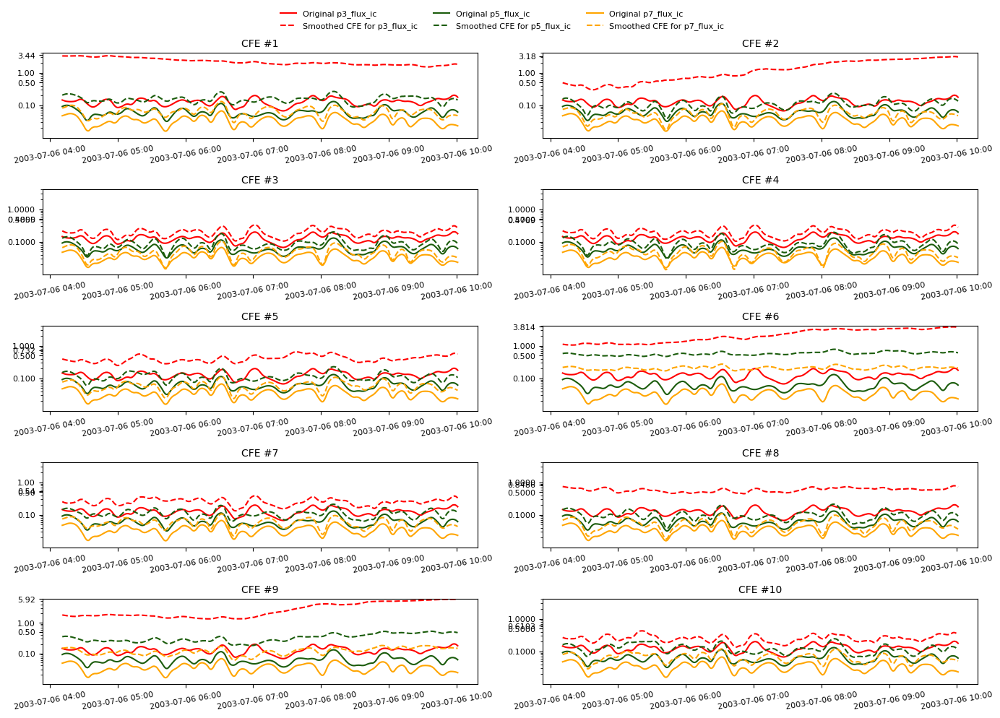

In [42]:
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.dates as mdates

window_size = 10  # Smoothing window

fig, axs = plt.subplots(5, 2, figsize=(14, 10), facecolor='white')
axs = axs.flatten()  # Flatten for easy iteration

for cfe_idx in range(10):
    sample_cfe = df_cfe_exp2.iloc[cfe_idx]

    # p3
    flux_type = 'p3_flux_ic'
    df_obs, final_series_p3, original_p3, min_y_p3, max_y_p3 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p3_smooth = original_p3.rolling(window=window_size, center=True).mean()
    final_series_p3_smooth = pd.Series(final_series_p3).rolling(window=window_size, center=True).mean()

    # p5
    flux_type = 'p5_flux_ic'
    df_obs_1, final_series_p5, original_p5, min_y_p5, max_y_p5 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p5_smooth = original_p5.rolling(window=window_size, center=True).mean()
    final_series_p5_smooth = pd.Series(final_series_p5).rolling(window=window_size, center=True).mean()

    # p7
    flux_type = 'p7_flux_ic'
    df_obs_2, final_series_p7, original_p7, min_y_p7, max_y_p7 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p7_smooth = original_p7.rolling(window=window_size, center=True).mean()
    final_series_p7_smooth = pd.Series(final_series_p7).rolling(window=window_size, center=True).mean()

    global_max_y = max(max_y_p3, max_y_p5, max_y_p7)

    ax = axs[cfe_idx]
    ax.set_facecolor('white')

    # Plot lines
    ax.plot(df_obs['time_stamp'], original_p3_smooth, label="Original p3_flux_ic", color="#FF0000")
    ax.plot(df_obs['time_stamp'], final_series_p3_smooth, label="Smoothed CFE for p3_flux_ic", color="#FF0000", linestyle='dashed')
    ax.plot(df_obs_1['time_stamp'], original_p5_smooth, label="Original p5_flux_ic", color="#1b5c0c")
    ax.plot(df_obs_1['time_stamp'], final_series_p5_smooth, label="Smoothed CFE for p5_flux_ic", color="#1b5c0c", linestyle='dashed')
    ax.plot(df_obs_2['time_stamp'], original_p7_smooth, label="Original p7_flux_ic", color="#FFA500")
    ax.plot(df_obs_2['time_stamp'], final_series_p7_smooth, label="Smoothed CFE for p7_flux_ic", color="#FFA500", linestyle='dashed')

    # ax.set_xlabel("Period of Observation", fontsize=9)
    # ax.set_ylabel("Particle Flux Unit (log scale)", fontsize=9)
    ax.set_yscale('log')
    ax.set_ylim(bottom=0.01, top=4)
    ax.set_yticks([0.1, 0.5, 1, global_max_y])
    ax.get_yaxis().set_major_formatter(plt.ScalarFormatter())
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
    plt.setp(ax.get_xticklabels(), rotation=10, ha='center', fontsize=8)
    plt.setp(ax.get_yticklabels(), fontsize=8)
    # if cfe_idx == 0:
    #     ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.15), ncol=3, frameon=False, fontsize=8)
    ax.set_title(f'CFE #{cfe_idx + 1}', fontsize=10)

handles, labels = axs[0].get_legend_handles_labels()
fig.legend(
    handles, labels,
    loc='upper center',
    bbox_to_anchor=(0.5, 0.995),  # Centered above the grid
    ncol=3,
    frameon=False,
    fontsize=8
)
plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the legend at the top
plt.show()



Experiment 3: Testing for odering penalty 1000

Experiment 2: Testing for Ordering Penalty 100

In [ ]:
PGC_explainer_exp3 = ConstrainedDiceGenetic(
    data_interface=data,
    model_interface=cfe_model,
    permitted_range_dict=filtered_dict_1,
    ordering_penalty=1000

)
# Generate counterfactuals
pg_cf_exp3 = PGC_explainer_exp3.generate_counterfactuals(
    query_instances=query_instance1,
    total_CFs=10,
    desired_class=1)

df_cfe_exp3 = pg_cf_exp3.cf_examples_list[0].final_cfs_df
pg_cf_exp3.cf_examples_list[0].final_cfs_df


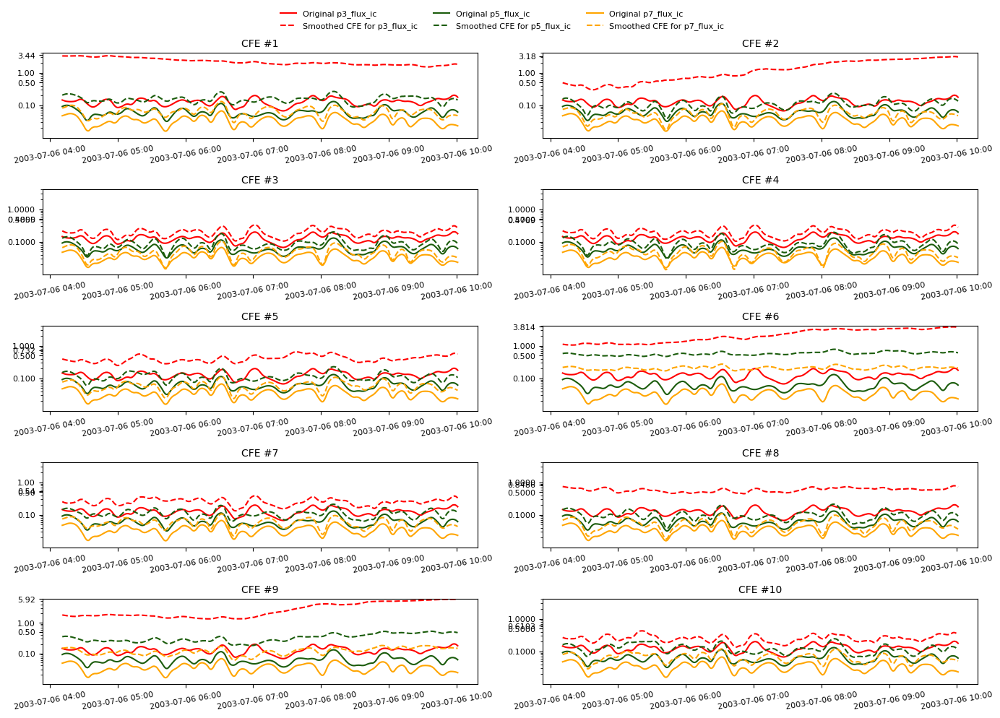

In [44]:
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.dates as mdates

window_size = 10  # Smoothing window

fig, axs = plt.subplots(5, 2, figsize=(14, 10), facecolor='white')
axs = axs.flatten()  # Flatten for easy iteration

for cfe_idx in range(10):
    sample_cfe = df_cfe_exp3.iloc[cfe_idx]

    # p3
    flux_type = 'p3_flux_ic'
    df_obs, final_series_p3, original_p3, min_y_p3, max_y_p3 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p3_smooth = original_p3.rolling(window=window_size, center=True).mean()
    final_series_p3_smooth = pd.Series(final_series_p3).rolling(window=window_size, center=True).mean()

    # p5
    flux_type = 'p5_flux_ic'
    df_obs_1, final_series_p5, original_p5, min_y_p5, max_y_p5 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p5_smooth = original_p5.rolling(window=window_size, center=True).mean()
    final_series_p5_smooth = pd.Series(final_series_p5).rolling(window=window_size, center=True).mean()

    # p7
    flux_type = 'p7_flux_ic'
    df_obs_2, final_series_p7, original_p7, min_y_p7, max_y_p7 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p7_smooth = original_p7.rolling(window=window_size, center=True).mean()
    final_series_p7_smooth = pd.Series(final_series_p7).rolling(window=window_size, center=True).mean()

    global_max_y = max(max_y_p3, max_y_p5, max_y_p7)

    ax = axs[cfe_idx]
    ax.set_facecolor('white')

    # Plot lines
    ax.plot(df_obs['time_stamp'], original_p3_smooth, label="Original p3_flux_ic", color="#FF0000")
    ax.plot(df_obs['time_stamp'], final_series_p3_smooth, label="Smoothed CFE for p3_flux_ic", color="#FF0000", linestyle='dashed')
    ax.plot(df_obs_1['time_stamp'], original_p5_smooth, label="Original p5_flux_ic", color="#1b5c0c")
    ax.plot(df_obs_1['time_stamp'], final_series_p5_smooth, label="Smoothed CFE for p5_flux_ic", color="#1b5c0c", linestyle='dashed')
    ax.plot(df_obs_2['time_stamp'], original_p7_smooth, label="Original p7_flux_ic", color="#FFA500")
    ax.plot(df_obs_2['time_stamp'], final_series_p7_smooth, label="Smoothed CFE for p7_flux_ic", color="#FFA500", linestyle='dashed')

    # ax.set_xlabel("Period of Observation", fontsize=9)
    # ax.set_ylabel("Particle Flux Unit (log scale)", fontsize=9)
    ax.set_yscale('log')
    ax.set_ylim(bottom=0.01, top=4)
    ax.set_yticks([0.1, 0.5, 1, global_max_y])
    ax.get_yaxis().set_major_formatter(plt.ScalarFormatter())
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
    plt.setp(ax.get_xticklabels(), rotation=10, ha='center', fontsize=8)
    plt.setp(ax.get_yticklabels(), fontsize=8)
    # if cfe_idx == 0:
    #     ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.15), ncol=3, frameon=False, fontsize=8)
    ax.set_title(f'CFE #{cfe_idx + 1}', fontsize=10)

handles, labels = axs[0].get_legend_handles_labels()
fig.legend(
    handles, labels,
    loc='upper center',
    bbox_to_anchor=(0.5, 0.995),  # Centered above the grid
    ncol=3,
    frameon=False,
    fontsize=8
)
plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the legend at the top
plt.show()



Experiment 4: testing ordering penalty 1e10

In [77]:
PGC_explainer_exp4 = ConstrainedDiceGenetic(
    data_interface=data,
    model_interface=cfe_model,
    permitted_range_dict=filtered_dict_1,
    ordering_penalty=1e10

)
# Generate counterfactuals
pg_cf_exp4 = PGC_explainer_exp4.generate_counterfactuals(
    query_instances=query_instance1,
    total_CFs=10,
    desired_class=1)

df_cfe_exp4 = pg_cf_exp4.cf_examples_list[0].final_cfs_df
pg_cf_exp4.cf_examples_list[0].final_cfs_df


100%|██████████| 1/1 [00:10<00:00, 10.66s/it]


p3_flux_ic_mean@[0:360]  p5_flux_ic_mean@[0:360]  p7_flux_ic_mean@[0:360]  \
0                 81.481392                    0.802                   0.0439   
1                  5.987222                    0.443                   0.0748   
2                  2.109736                    0.093                   0.0298   
3                  1.282046                    0.048                   0.0210   
4                  0.066990                    0.026                   0.0139   
5                  5.894566                    0.655                   0.0689   
6                  6.275195                    0.182                   0.0497   
7                  4.687955                    0.516                   0.0742   
8                  0.065150                    0.025                   0.0138   
9                  0.283040                    0.052                   0.0248   
10                 7.550833                    1.713                   0.5658   
11                 2.078878                    0.511                   0.1733   
12                 0.126173                    0.049                   0.0236   
13                 0.460889                    0.038                   0.0182   
14                 2.828885                    0.271                   0.0882   
15                 0.126058                    0.063                   0.0315   
16                 0.460889                    0.038                   0.0182   
17                 0.339046                    0.097                   0.0390   
18                39.723610                    2.895                   0.3202   
19                 0.460889                    0.038                   0.0182   

    long_mean@[0:360]  p3_flux_ic_mean@[0:180]  p5_flux_ic_mean@[0:180]  \
0        1.186920e-06                89.552223                    0.899   
1        1.952920e-06                 5.988345                    0.462   
2        1.129920e-06                 2.617722                    0.091   
3        1.111360e-06                 0.360731                    0.034   
4        1.365790e-06                 0.065914                    0.024   
5        1.168550e-06                 6.184311                    0.682   
6        7.835200e-07                 4.756889                    0.118   
7        1.991600e-06                 4.186167                    0.547   
8        1.393490e-06                 0.064356                    0.025   
9        1.332360e-06                 0.224144                    0.051   
10       1.271930e-06                 8.292833                    1.871   
11       5.702100e-07                 1.087783                    0.462   
12       1.139710e-06                 0.137980                    0.050   
13       1.710810e-06                 0.429244                    0.039   
14       1.502260e-06                 1.274989                    0.188   
15       2.868940e-06                 0.127362                    0.075   
16       1.007200e-07                 0.065914                    0.039   
17       3.897400e-06                 0.247614                    0.049   
18       1.631760e-06                43.867222                    2.935   
19       1.332360e-06                 0.224144                    0.051   

    p7_flux_ic_mean@[0:180]  long_mean@[0:180]  p3_flux_ic_mean@[90:270]  \
0                    0.0409       1.203680e-06                 88.900002   
1                    0.0783       1.993410e-06                  6.527711   
2                    0.0308       1.007670e-06                  1.930250   
3                    0.0179       1.311880e-06                  1.084250   
4                    0.0130       1.171600e-06                  0.070457   
5                    0.0710       1.266680e-06                  6.125900   
6                    0.0479       1.071210e-06                  7.557000   
7                    0.0770       1.047100e-06                  4.490111   
8                    0.0146       1.194550

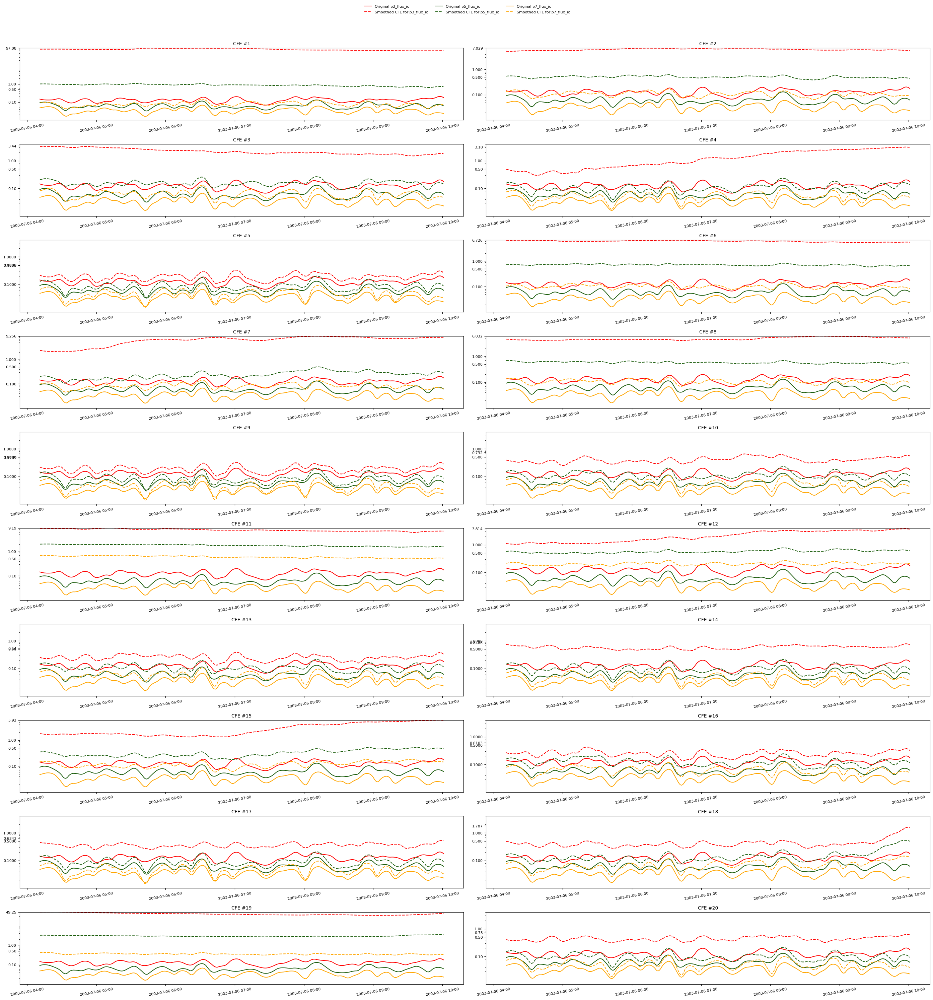

In [78]:
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.dates as mdates

window_size = 10  # Smoothing window

fig, axs = plt.subplots(5, 2, figsize=(28, 30), facecolor='white')
axs = axs.flatten()  # Flatten for easy iteration

for cfe_idx in range(10):
    sample_cfe = df_cfe_exp4.iloc[cfe_idx]

    # p3
    flux_type = 'p3_flux_ic'
    df_obs, final_series_p3, original_p3, min_y_p3, max_y_p3 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p3_smooth = original_p3.rolling(window=window_size, center=True).mean()
    final_series_p3_smooth = pd.Series(final_series_p3).rolling(window=window_size, center=True).mean()

    # p5
    flux_type = 'p5_flux_ic'
    df_obs_1, final_series_p5, original_p5, min_y_p5, max_y_p5 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p5_smooth = original_p5.rolling(window=window_size, center=True).mean()
    final_series_p5_smooth = pd.Series(final_series_p5).rolling(window=window_size, center=True).mean()

    # p7
    flux_type = 'p7_flux_ic'
    df_obs_2, final_series_p7, original_p7, min_y_p7, max_y_p7 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p7_smooth = original_p7.rolling(window=window_size, center=True).mean()
    final_series_p7_smooth = pd.Series(final_series_p7).rolling(window=window_size, center=True).mean()

    global_max_y = max(max_y_p3, max_y_p5, max_y_p7)

    ax = axs[cfe_idx]
    ax.set_facecolor('white')

    # Plot lines
    ax.plot(df_obs['time_stamp'], original_p3_smooth, label="Original p3_flux_ic", color="#FF0000")
    ax.plot(df_obs['time_stamp'], final_series_p3_smooth, label="Smoothed CFE for p3_flux_ic", color="#FF0000", linestyle='dashed')
    ax.plot(df_obs_1['time_stamp'], original_p5_smooth, label="Original p5_flux_ic", color="#1b5c0c")
    ax.plot(df_obs_1['time_stamp'], final_series_p5_smooth, label="Smoothed CFE for p5_flux_ic", color="#1b5c0c", linestyle='dashed')
    ax.plot(df_obs_2['time_stamp'], original_p7_smooth, label="Original p7_flux_ic", color="#FFA500")
    ax.plot(df_obs_2['time_stamp'], final_series_p7_smooth, label="Smoothed CFE for p7_flux_ic", color="#FFA500", linestyle='dashed')
    #
    # ax.set_xlabel("Period of Observation", fontsize=9)
    # ax.set_ylabel("Particle Flux Unit (log scale)", fontsize=9)
    ax.set_yscale('log')
    ax.set_ylim(bottom=0.01, top=4)
    ax.set_yticks([0.1, 0.5, 1, global_max_y])
    ax.get_yaxis().set_major_formatter(plt.ScalarFormatter())
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
    plt.setp(ax.get_xticklabels(), rotation=10, ha='center', fontsize=8)
    plt.setp(ax.get_yticklabels(), fontsize=8)
    # if cfe_idx == 0:
    #     ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.15), ncol=3, frameon=False, fontsize=8)
    ax.set_title(f'CFE #{cfe_idx + 1}', fontsize=10)

handles, labels = axs[0].get_legend_handles_labels()
fig.legend(
    handles, labels,
    loc='upper center',
    bbox_to_anchor=(0.5, 0.995),  # Centered above the grid
    ncol=3,
    frameon=False,
    fontsize=8
)
plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the legend at the top
plt.show()



DiCE Proximity: 1959.881
DiCE Sparsity: 927.900
DiCE Diversity (Mean Pairwise L1): 3333.596
DiCE Diversity Std Dev: 5597.727


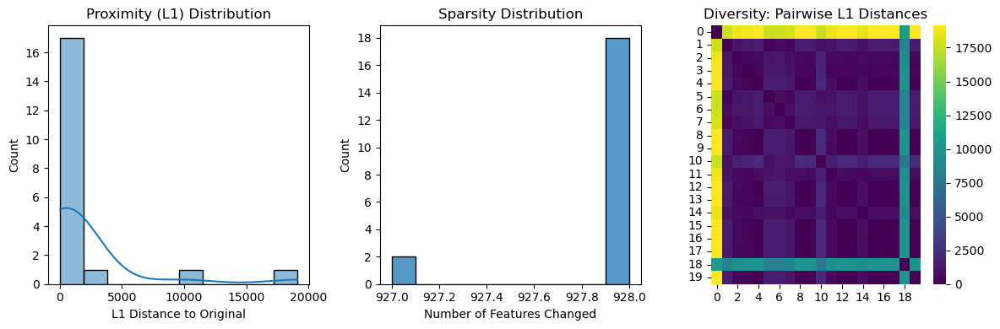

In [79]:
import numpy as np
from scipy.spatial.distance import cdist
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MaxNLocator

# Convert DataFrame to NumPy array
cf_array = df_cfe_exp4.iloc[:, :-1].values  # Remove last column if label exists
original = query_instance1.values.flatten()

N, d = cf_array.shape

# --- Proximity (DiCE) ---
proximity = np.mean(np.sum(np.abs(cf_array - original), axis=1))

# --- Sparsity (DiCE) ---
sparsity = np.mean(np.sum(cf_array != original, axis=1))

# --- Diversity (DiCE) ---
pairwise_l1 = cdist(cf_array, cf_array, metric='cityblock')  # L1 distance matrix
triu_indices = np.triu_indices(N, k=1)
pairwise_l1_values = pairwise_l1[triu_indices]

diversity_mean = np.mean(pairwise_l1_values)
diversity_std = np.std(pairwise_l1_values)

print(f"DiCE Proximity: {proximity:.3f}")
print(f"DiCE Sparsity: {sparsity:.3f}")
print(f"DiCE Diversity (Mean Pairwise L1): {diversity_mean:.3f}")
print(f"DiCE Diversity Std Dev: {diversity_std:.3f}")

# --- Visualization ---

plt.figure(figsize=(12, 4))

# Proximity distribution
plt.subplot(1, 3, 1)
sns.histplot(np.sum(np.abs(cf_array - original), axis=1), kde=True, bins=10)
plt.title("Proximity (L1) Distribution")
plt.xlabel("L1 Distance to Original")

# Sparsity distribution
plt.subplot(1, 3, 2)
sns.histplot(np.sum(cf_array != original, axis=1), kde=False, bins=10)
plt.title("Sparsity Distribution")
plt.xlabel("Number of Features Changed")
plt.gca().yaxis.set_major_locator(MaxNLocator(integer=True))

# Diversity heatmap
plt.subplot(1, 3, 3)
sns.heatmap(pairwise_l1, cmap="viridis", cbar=True)
plt.title("Diversity: Pairwise L1 Distances")

plt.tight_layout()
plt.show()


NORMALIZED DATA

Normalized DiCE Proximity: 152.380
Normalized DiCE Sparsity: 864.000
Normalized DiCE Diversity (Mean Pairwise L1): 186.399
Normalized DiCE Diversity Std Dev: 150.324


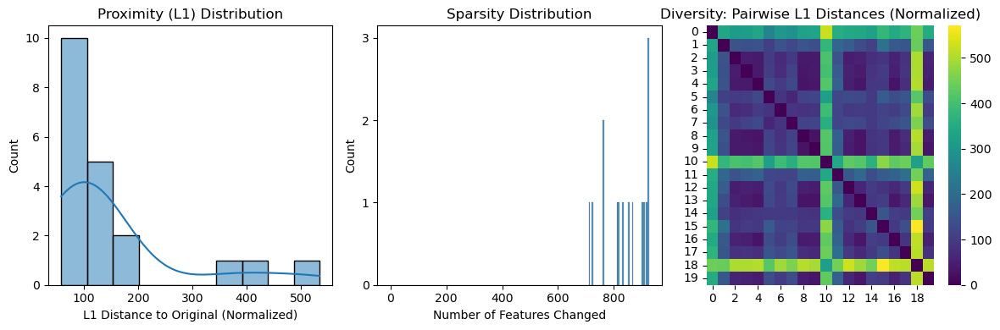

In [80]:
import numpy as np
from scipy.spatial.distance import cdist
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MaxNLocator
from sklearn.preprocessing import MinMaxScaler  # or use StandardScaler for z-score

# --- Data Preparation ---
cf_array = df_cfe_exp_genetic_4.iloc[:, :-1].values  # Counterfactuals (without label)
original = query_instance1.values.flatten().reshape(1, -1)  # Query instance

# --- Normalize both counterfactuals and original together ---
scaler = MinMaxScaler()
cf_all = np.vstack([cf_array, original])  # Stack to fit scaler across both
cf_all_scaled = scaler.fit_transform(cf_all)

cf_array_scaled = cf_all_scaled[:-1]
original_scaled = cf_all_scaled[-1].reshape(1, -1)

N, d = cf_array_scaled.shape

# --- DiCE Metrics (on normalized data) ---

# Proximity
proximity = np.mean(np.sum(np.abs(cf_array_scaled - original_scaled), axis=1))

# Sparsity with small threshold to avoid floating point noise
sparsity = np.mean(np.sum(cf_array != original, axis=1))

# Diversity: pairwise L1 distances among CFs
pairwise_l1 = cdist(cf_array_scaled, cf_array_scaled, metric='cityblock')
triu_indices = np.triu_indices(N, k=1)
pairwise_l1_values = pairwise_l1[triu_indices]

diversity_mean = np.mean(pairwise_l1_values)
diversity_std = np.std(pairwise_l1_values)

print(f"Normalized DiCE Proximity: {proximity:.3f}")
print(f"Normalized DiCE Sparsity: {sparsity:.3f}")
print(f"Normalized DiCE Diversity (Mean Pairwise L1): {diversity_mean:.3f}")
print(f"Normalized DiCE Diversity Std Dev: {diversity_std:.3f}")

# --- Visualization ---

plt.figure(figsize=(12, 4))

# Proximity distribution
plt.subplot(1, 3, 1)
sns.histplot(np.sum(np.abs(cf_array_scaled - original_scaled), axis=1), kde=True, bins=10)
plt.title("Proximity (L1) Distribution")
plt.xlabel("L1 Distance to Original (Normalized)")

# Sparsity distribution
plt.subplot(1, 3, 2)
sns.histplot(np.mean(np.sum(cf_array != original, axis=1)), bins=range(0, d+1, 5))
plt.title("Sparsity Distribution")
plt.xlabel("Number of Features Changed")
plt.gca().yaxis.set_major_locator(MaxNLocator(integer=True))

# Diversity heatmap
plt.subplot(1, 3, 3)
sns.heatmap(pairwise_l1, cmap="viridis", cbar=True)
plt.title("Diversity: Pairwise L1 Distances (Normalized)")

plt.tight_layout()
plt.show()


l0 PENALTY ADDED

In [104]:
from dice_ml.explainer_interfaces.dice_genetic import DiceGenetic
import numpy as np

class ConstrainedDiceGenetic(DiceGenetic):
    def __init__(
        self,
        data_interface,
        model_interface,
        permitted_range_dict,
        ordering_penalty=1e4,
        l0_penalty_weight=0,
        proximity_weight=0.5,
        sparsity_weight=0.5,
        diversity_weight=1.0,
        **kwargs
    ):
        super().__init__(data_interface, model_interface, **kwargs)
        self.permitted_range_dict = permitted_range_dict
        self.ordering_penalty = ordering_penalty
        self.l0_penalty_weight = l0_penalty_weight
        self.proximity_weight = proximity_weight
        self.sparsity_weight = sparsity_weight
        self.diversity_weight = diversity_weight

        # Identify all windows from the permitted_range_dict
        self.windows = []
        for fname in permitted_range_dict:
            if fname.startswith('p3_flux_ic_mean@'):
                window = fname.split('@')[1]
                self.windows.append(window)

        # Build feature name mapping for each window
        self.feature_triplets = []
        for window in self.windows:
            p3 = f'p3_flux_ic_mean@{window}'
            p5 = f'p5_flux_ic_mean@{window}'
            p7 = f'p7_flux_ic_mean@{window}'
            if (p3 in data_interface.feature_names and
                p5 in data_interface.feature_names and
                p7 in data_interface.feature_names):
                self.feature_triplets.append((p3, p5, p7))

        # Build index mapping for fast access
        self.feature_indices = []
        for p3, p5, p7 in self.feature_triplets:
            idx3 = data_interface.feature_names.index(p3)
            idx5 = data_interface.feature_names.index(p5)
            idx7 = data_interface.feature_names.index(p7)
            self.feature_indices.append((idx3, idx5, idx7))

    def _ordering_constraint_penalty(self, candidates):
        penalty = np.zeros(candidates.shape[0])
        for idx3, idx5, idx7 in self.feature_indices:
            p3 = candidates[:, idx3]
            p5 = candidates[:, idx5]
            p7 = candidates[:, idx7]
            violations = (p3 >= 10) | (p3 <= p5) | (p5 <= p7)
            penalty += violations.astype(float) * self.ordering_penalty
        return penalty

    def _range_constraint_penalty(self, candidates):
        penalty = np.zeros(candidates.shape[0])
        for fname, (fmin, fmax) in self.permitted_range_dict.items():
            if fname in self.data_interface.feature_names:
                idx = self.data_interface.feature_names.index(fname)
                vals = candidates[:, idx]
                out_of_bounds = (vals < fmin) | (vals > fmax)
                penalty += out_of_bounds.astype(float) * self.ordering_penalty
        return penalty

    def _l0_penalty(self, candidates, query_instance):
        if query_instance.ndim > 1:
            query_instance = query_instance.flatten()
        diff = candidates != query_instance
        l0 = np.sum(diff, axis=1)
        return l0 * self.l0_penalty_weight

    def compute_proximity_loss(self, candidates, query_instance):
        # L1 norm
        return np.sum(np.abs(candidates - query_instance), axis=1)

    def compute_sparsity_loss(self, cfs):
        sparsity_loss = np.count_nonzero(cfs - self.x1, axis=1)
        return sparsity_loss / len(self.data_interface.feature_names)

    def compute_diversity_loss(self, candidates):
        # Mean pairwise L1 distance (lower means less diversity)
        from scipy.spatial.distance import pdist
        if candidates.shape[0] < 2:
            return np.zeros(candidates.shape[0])
        dists = pdist(candidates, metric='cityblock')
        mean_div = np.mean(dists)
        # Assign the same diversity loss to all candidates (for simplicity)
        return np.full(candidates.shape[0], mean_div)

    def _fitness_fn(self, candidates, query_instance, desired_class, **kwargs):
        # Get base fitness from parent (usually y-loss, i.e., model outcome loss)
        fitness = super()._fitness_fn(candidates, query_instance, desired_class, **kwargs)
        # Add proximity, sparsity, and (negative) diversity losses
        fitness += self.proximity_weight * self.compute_proximity_loss(candidates, query_instance)
        fitness += self.sparsity_weight * self.compute_sparsity_loss(candidates, query_instance)
        # Subtract diversity to encourage more diversity (higher is better)
        fitness -= self.diversity_weight * self.compute_diversity_loss(candidates)
        # Add custom penalties
        fitness += self._ordering_constraint_penalty(candidates)
        fitness += self._range_constraint_penalty(candidates)
        fitness += self._l0_penalty(candidates, query_instance)
        return fitness


In [111]:
explainer.x1 = query_instance1
explainer = ConstrainedDiceGenetic(
    data_interface=data,
    model_interface=cfe_model,
    permitted_range_dict=filtered_dict_1,
    ordering_penalty=10,
    proximity_weight=0.2,
    sparsity_weight=200,
    diversity_weight=20
)
# Generate counterfactuals
cf = explainer.generate_counterfactuals(
    query_instances=query_instance1,
    total_CFs=30,
    desired_class=1)
cfe_exp = []  # Initialize the list before the loop

cfe_df = cf.cf_examples_list[0].final_cfs_df
cfe_exp.append(cfe_df)  # Append each DataFrame

# Concatenate once after the loop
df_cfe_exp_genetic_5 = pd.concat(cfe_exp, ignore_index=True)
df_cfe_exp_genetic_5


100%|██████████| 1/1 [00:30<00:00, 30.21s/it]


p3_flux_ic_mean@[0:360]  p5_flux_ic_mean@[0:360]  p7_flux_ic_mean@[0:360]  \
0                  0.000000                     0.00                   0.0000   
1                  0.000000                     0.00                   0.0102   
2                  0.000000                     0.00                   0.0000   
3                  0.058025                     0.00                   0.0102   
4                  0.058025                     0.00                   0.0000   
5                  0.000000                     0.00                   0.0102   
6                  0.058025                     0.00                   0.0102   
7                  0.058025                     0.00                   0.0102   
8                  0.058025                     0.02                   0.0000   
9                  0.000000                     0.02                   0.0102   
10                 0.058025                     0.02                   0.0102   
11                 0.000000                     0.02                   0.0102   
12                 0.000000                     0.00                   0.0102   
13                 0.000000                     0.00                   0.0102   
14                 0.058025                     0.02                   0.0102   
15                 0.058025                     0.02                   0.0102   
16                 0.000000                     0.02                   0.0102   
17                 0.000000                     0.00                   0.0102   
18                 0.000000                     0.00                   0.0000   
19                 0.000000                     0.02                   0.0000   
20                 0.000000                     0.00                   0.0102   
21                 0.000000                     0.00                   0.0102   
22                 0.000000                     0.00                   0.0102   
23                 0.058025                     0.00                   0.0102   
24                 0.000000                     0.02                   0.0102   
25                 0.000000                     0.02                   0.0102   
26                 0.000000                     0.00                   0.0102   
27                 0.000000                     0.00                   0.0102   
28                 0.000000                     0.00                   0.0000   
29                 0.058025                     0.00                   0.0102   

    long_mean@[0:360]  p3_flux_ic_mean@[0:180]  p5_flux_ic_mean@[0:180]  \
0        0.000000e+00                  0.00000                    0.000   
1        0.000000e+00                  0.05369                    0.019   
2        1.007200e-07                  0.00000                    0.000   
3        0.000000e+00                  0.05369                    0.019   
4        0.000000e+00                  0.05369                    0.019   
5        1.007200e-07                  0.05369                    0.019   
6        1.007200e-07                  0.05369                    0.000   
7        0.000000e+00                  0.00000                    0.019   
8        0.000000e+00                  0.05369                    0.019   
9        0.000000e+00                  0.05369                    0.019   
10       1.007200e-07                  0.00000                    0.019   
11       0.000000e+00                  0.05369                    0.019   
12       1.007200e-07                  0.05369                    0.019   
13       1.007200e-07                  0.05369                    0.019   
14       0.000000e+00                  0.00000                    0.019   
15       1.007200e-07                  0.05369                    0.019   
16       0.000000e+00                  0.05369                    0.019   
17       1.007200e-07                  0.05369                    0.019   
18       1.007200e-07                  0.00000                    0

Normalized DiCE Proximity: 698.177
Normalized DiCE Sparsity: 928.000
Normalized DiCE Diversity (Mean Pairwise L1): 98.211
Normalized DiCE Diversity Std Dev: 30.294


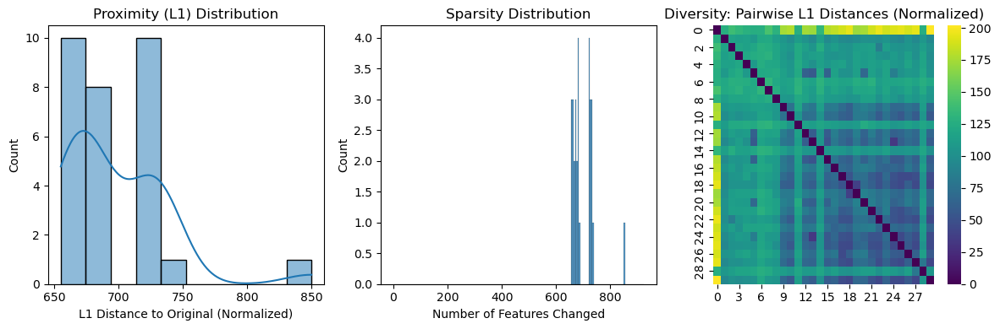

In [116]:
import numpy as np
from scipy.spatial.distance import cdist
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MaxNLocator
from sklearn.preprocessing import MinMaxScaler  # or use StandardScaler for z-score

# --- Data Preparation ---
cf_array = df_cfe_exp_genetic_5.iloc[:, :-1].values  # Counterfactuals (without label)
original = query_instance1.values.flatten().reshape(1, -1)  # Query instance

# --- Normalize both counterfactuals and original together ---
scaler = MinMaxScaler()
cf_all = np.vstack([cf_array, original])  # Stack to fit scaler across both
cf_all_scaled = scaler.fit_transform(cf_all)

cf_array_scaled = cf_all_scaled[:-1]
original_scaled = cf_all_scaled[-1].reshape(1, -1)

N, d = cf_array_scaled.shape

# --- DiCE Metrics (on normalized data) ---

# Proximity
proximity = np.mean(np.sum(np.abs(cf_array_scaled - original_scaled), axis=1))


sparsity = np.mean(np.sum(cf_array != original, axis=1))

# Diversity: pairwise L1 distances among CFs
pairwise_l1 = cdist(cf_array_scaled, cf_array_scaled, metric='cityblock')
triu_indices = np.triu_indices(N, k=1)
pairwise_l1_values = pairwise_l1[triu_indices]

diversity_mean = np.mean(pairwise_l1_values)
diversity_std = np.std(pairwise_l1_values)

print(f"Normalized DiCE Proximity: {proximity:.3f}")
print(f"Normalized DiCE Sparsity: {sparsity:.3f}")
print(f"Normalized DiCE Diversity (Mean Pairwise L1): {diversity_mean:.3f}")
print(f"Normalized DiCE Diversity Std Dev: {diversity_std:.3f}")

# --- Visualization ---

plt.figure(figsize=(12, 4))

# Proximity distribution
plt.subplot(1, 3, 1)
sns.histplot(np.sum(np.abs(cf_array_scaled - original_scaled), axis=1), kde=True, bins=10)
plt.title("Proximity (L1) Distribution")
plt.xlabel("L1 Distance to Original (Normalized)")

# Sparsity distribution
plt.subplot(1, 3, 2)
sns.histplot(np.mean(np.sum(cf_array != original, axis=1)), bins=range(0, d+1, 5))
plt.title("Sparsity Distribution")
plt.xlabel("Number of Features Changed")


# Diversity heatmap
plt.subplot(1, 3, 3)
sns.heatmap(pairwise_l1, cmap="viridis", cbar=True)
plt.title("Diversity: Pairwise L1 Distances (Normalized)")

plt.tight_layout()
plt.show()


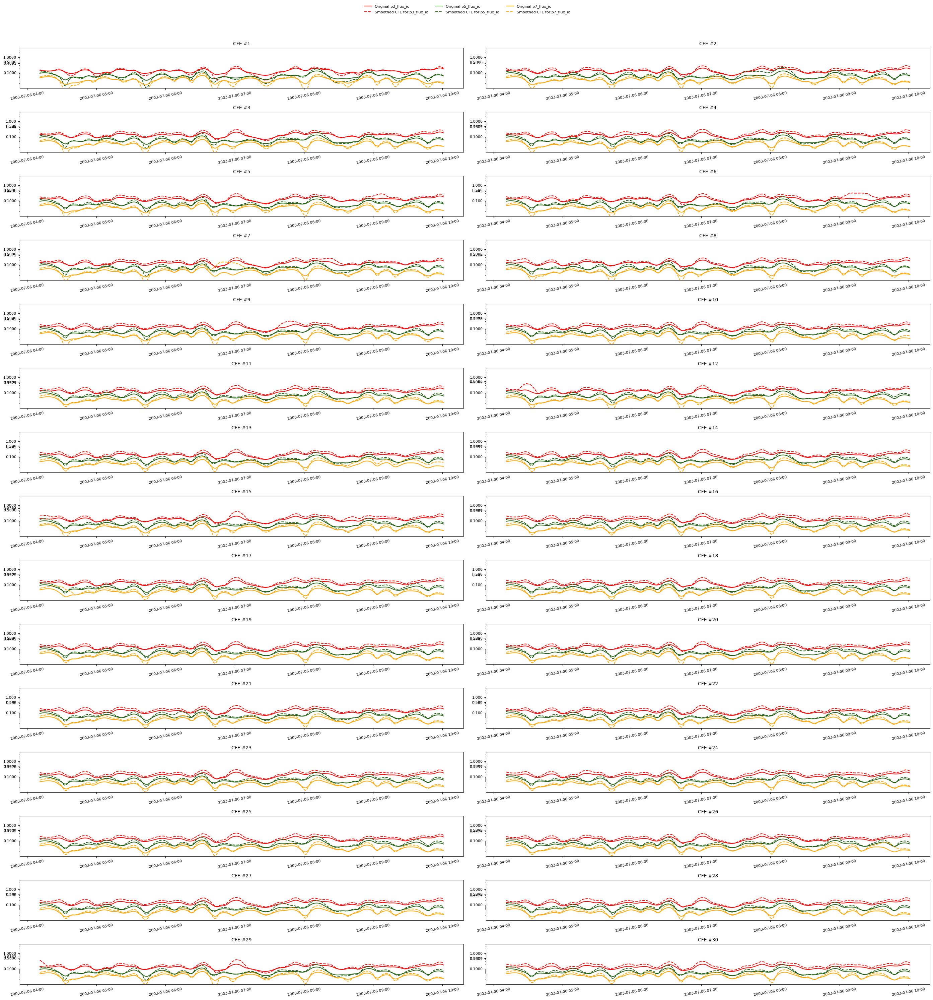

In [114]:
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.dates as mdates

window_size = 10  # Smoothing window

fig, axs = plt.subplots(15, 2, figsize=(28, 30), facecolor='white')
axs = axs.flatten()  # Flatten for easy iteration

for cfe_idx in range(30):
    sample_cfe = df_cfe_exp_genetic_5.iloc[cfe_idx]

    # p3
    flux_type = 'p3_flux_ic'
    df_obs, final_series_p3, original_p3, min_y_p3, max_y_p3 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p3_smooth = original_p3.rolling(window=window_size, center=True).mean()
    final_series_p3_smooth = pd.Series(final_series_p3).rolling(window=window_size, center=True).mean()

    # p5
    flux_type = 'p5_flux_ic'
    df_obs_1, final_series_p5, original_p5, min_y_p5, max_y_p5 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p5_smooth = original_p5.rolling(window=window_size, center=True).mean()
    final_series_p5_smooth = pd.Series(final_series_p5).rolling(window=window_size, center=True).mean()

    # p7
    flux_type = 'p7_flux_ic'
    df_obs_2, final_series_p7, original_p7, min_y_p7, max_y_p7 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p7_smooth = original_p7.rolling(window=window_size, center=True).mean()
    final_series_p7_smooth = pd.Series(final_series_p7).rolling(window=window_size, center=True).mean()

    global_max_y = max(max_y_p3, max_y_p5, max_y_p7)

    ax = axs[cfe_idx]
    ax.set_facecolor('white')

    # Plot lines
    ax.plot(df_obs['time_stamp'], original_p3_smooth, label="Original p3_flux_ic", color="#FF0000")
    ax.plot(df_obs['time_stamp'], final_series_p3_smooth, label="Smoothed CFE for p3_flux_ic", color="#FF0000", linestyle='dashed')
    ax.plot(df_obs_1['time_stamp'], original_p5_smooth, label="Original p5_flux_ic", color="#1b5c0c")
    ax.plot(df_obs_1['time_stamp'], final_series_p5_smooth, label="Smoothed CFE for p5_flux_ic", color="#1b5c0c", linestyle='dashed')
    ax.plot(df_obs_2['time_stamp'], original_p7_smooth, label="Original p7_flux_ic", color="#FFA500")
    ax.plot(df_obs_2['time_stamp'], final_series_p7_smooth, label="Smoothed CFE for p7_flux_ic", color="#FFA500", linestyle='dashed')
    #
    # ax.set_xlabel("Period of Observation", fontsize=9)
    # ax.set_ylabel("Particle Flux Unit (log scale)", fontsize=9)
    ax.set_yscale('log')
    ax.set_ylim(bottom=0.01, top=4)
    ax.set_yticks([0.1, 0.5, 1, global_max_y])
    ax.get_yaxis().set_major_formatter(plt.ScalarFormatter())
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
    plt.setp(ax.get_xticklabels(), rotation=10, ha='center', fontsize=8)
    plt.setp(ax.get_yticklabels(), fontsize=8)
    # if cfe_idx == 0:
    #     ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.15), ncol=3, frameon=False, fontsize=8)
    ax.set_title(f'CFE #{cfe_idx + 1}', fontsize=10)

handles, labels = axs[0].get_legend_handles_labels()
fig.legend(
    handles, labels,
    loc='upper center',
    bbox_to_anchor=(0.5, 0.995),  # Centered above the grid
    ncol=3,
    frameon=False,
    fontsize=8
)
plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the legend at the top
plt.show()



In [132]:
explainer.x1 = query_instance1
explainer = ConstrainedDiceGenetic(
    data_interface=data,
    model_interface=cfe_model,
    permitted_range_dict={},
    ordering_penalty=10,
    l0_penalty_weight=10,
    proximity_weight=1.0,     # Increase to make CFs closer
    sparsity_weight=10.0,     # Lower to reasonable scale
    diversity_weight=5        # Lower to reduce conflict with sparsity/proximity
)

# Generate counterfactuals
cf = explainer.generate_counterfactuals(
    query_instances=query_instance1,
    total_CFs=30,
    desired_class=1)
cfe_exp = []  # Initialize the list before the loop

cfe_df = cf.cf_examples_list[0].final_cfs_df
cfe_exp.append(cfe_df)  # Append each DataFrame

# Concatenate once after the loop
df_cfe_exp_genetic_5 = pd.concat(cfe_exp, ignore_index=True)
df_cfe_exp_genetic_5


100%|██████████| 1/1 [00:23<00:00, 23.98s/it]


p3_flux_ic_mean@[0:360]  p5_flux_ic_mean@[0:360]  p7_flux_ic_mean@[0:360]  \
0                  0.000000                     0.00                   0.0000   
1                  0.000000                     0.00                   0.0000   
2                  0.000000                     0.00                   0.0000   
3                  0.000000                     0.00                   0.0000   
4                  0.058025                     0.00                   0.0000   
5                  0.058025                     0.00                   0.0102   
6                  0.000000                     0.02                   0.0102   
7                  0.000000                     0.02                   0.0000   
8                  0.058025                     0.02                   0.0102   
9                  0.058025                     0.00                   0.0102   
10                 0.000000                     0.02                   0.0000   
11                 0.000000                     0.00                   0.0000   
12                 0.000000                     0.00                   0.0102   
13                 0.058025                     0.02                   0.0102   
14                 0.000000                     0.00                   0.0000   
15                 0.000000                     0.00                   0.0102   
16                 0.000000                     0.00                   0.0102   
17                 0.058025                     0.00                   0.0000   
18                 0.000000                     0.02                   0.0102   
19                 0.000000                     0.00                   0.0000   
20                 0.000000                     0.00                   0.0000   
21                 0.000000                     0.00                   0.0000   
22                 0.000000                     0.00                   0.0102   
23                 0.058025                     0.02                   0.0000   
24                 0.058025                     0.00                   0.0000   
25                 0.000000                     0.00                   0.0000   
26                 0.000000                     0.02                   0.0000   
27                 0.000000                     0.00                   0.0102   
28                 0.000000                     0.02                   0.0000   
29                 0.000000                     0.00                   0.0000   

    long_mean@[0:360]  p3_flux_ic_mean@[0:180]  p5_flux_ic_mean@[0:180]  \
0        0.000000e+00                  0.00000                    0.000   
1        0.000000e+00                  0.00000                    0.000   
2        0.000000e+00                  0.00000                    0.000   
3        0.000000e+00                  0.00000                    0.019   
4        1.007200e-07                  0.00000                    0.000   
5        1.007200e-07                  0.00000                    0.000   
6        1.007200e-07                  0.00000                    0.000   
7        0.000000e+00                  0.00000                    0.019   
8        0.000000e+00                  0.05369                    0.000   
9        0.000000e+00                  0.00000                    0.030   
10       1.007200e-07                  0.05369                    0.019   
11       0.000000e+00                  0.05369                    0.000   
12       1.007200e-07                  0.00000                    0.019   
13       0.000000e+00                  0.00000                    0.019   
14       0.000000e+00                  0.05369                    0.019   
15       1.007200e-07                  0.00000                    0.019   
16       1.007200e-07                  0.00000                    0.000   
17       1.007200e-07                  0.00000                    0.019   
18       0.000000e+00                  0.00000                    0

Normalized DiCE Proximity: 710.748
Normalized DiCE Sparsity: 928.000
Normalized DiCE Diversity (Mean Pairwise L1): 113.043
Normalized DiCE Diversity Std Dev: 20.602


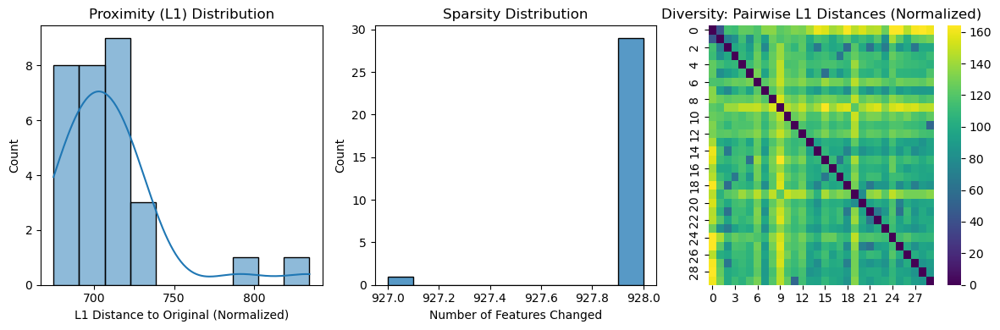

In [133]:
import numpy as np
from scipy.spatial.distance import cdist
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MaxNLocator
from sklearn.preprocessing import MinMaxScaler  # or use StandardScaler for z-score

# --- Data Preparation ---
cf_array = df_cfe_exp_genetic_5.iloc[:, :-1].values  # Counterfactuals (without label)
original = query_instance1.values.flatten().reshape(1, -1)  # Query instance

# --- Normalize both counterfactuals and original together ---
scaler = MinMaxScaler()
cf_all = np.vstack([cf_array, original])  # Stack to fit scaler across both
cf_all_scaled = scaler.fit_transform(cf_all)

cf_array_scaled = cf_all_scaled[:-1]
original_scaled = cf_all_scaled[-1].reshape(1, -1)

N, d = cf_array_scaled.shape

# --- DiCE Metrics (on normalized data) ---

# Proximity
proximity = np.mean(np.sum(np.abs(cf_array_scaled - original_scaled), axis=1))

epsilon = 1e-3
sparsity_values = np.sum(np.abs(cf_array_scaled - original_scaled) > epsilon, axis=1)

# Diversity: pairwise L1 distances among CFs
pairwise_l1 = cdist(cf_array_scaled, cf_array_scaled, metric='cityblock')
triu_indices = np.triu_indices(N, k=1)
pairwise_l1_values = pairwise_l1[triu_indices]

diversity_mean = np.mean(pairwise_l1_values)
diversity_std = np.std(pairwise_l1_values)

print(f"Normalized DiCE Proximity: {proximity:.3f}")
print(f"Normalized DiCE Sparsity: {sparsity:.3f}")
print(f"Normalized DiCE Diversity (Mean Pairwise L1): {diversity_mean:.3f}")
print(f"Normalized DiCE Diversity Std Dev: {diversity_std:.3f}")

# --- Visualization ---

plt.figure(figsize=(12, 4))

# Proximity distribution
plt.subplot(1, 3, 1)
sns.histplot(proximity, kde=True, bins=10)
plt.title("Proximity (L1) Distribution")
plt.xlabel("L1 Distance to Original (Normalized)")

# Sparsity distribution
plt.subplot(1, 3, 2)
sns.histplot(sparsity_values, bins=10)
plt.title("Sparsity Distribution")
plt.xlabel("Number of Features Changed")


# Diversity heatmap
plt.subplot(1, 3, 3)
sns.heatmap(pairwise_l1, cmap="viridis", cbar=True)
plt.title("Diversity: Pairwise L1 Distances (Normalized)")

plt.tight_layout()
plt.show()


In [139]:
import numpy as np
import pandas as pd
from itertools import product
import os
from sklearn.preprocessing import MinMaxScaler
from scipy.spatial.distance import pdist

# --- Logging function from earlier ---
def log_multiple_runs(
    filename,
    run_id,
    proximity_weight,
    sparsity_weight,
    diversity_weight,
    l0_penalty_weight,
    ordering_penalty,
    proximity,
    sparsity,
    diversity_mean,
    diversity_std
):
    row = {
        'run_id': run_id,
        'proximity_weight': proximity_weight,
        'sparsity_weight': sparsity_weight,
        'diversity_weight': diversity_weight,
        'l0_penalty_weight': l0_penalty_weight,
        'ordering_penalty': ordering_penalty,
        'proximity': proximity,
        'sparsity': sparsity,
        'diversity_mean_pairwise_l1': diversity_mean,
        'diversity_stddev': diversity_std
    }
    if os.path.exists(filename):
        df = pd.read_csv(filename)
        df = pd.concat([df, pd.DataFrame([row])], ignore_index=True)
    else:
        df = pd.DataFrame([row])
    df.to_csv(filename, index=False)

# --- Hyperparameter grid setup ---
proximity_weights = [10.0, 100.0]
sparsity_weights = [10.0, 100.0]
diversity_weights = [1, 5, 10]
l0_penalty_weights = [0, 1, 10, 100]
ordering_penalties = [1, 10, 100]

param_grid = list(product(
    proximity_weights,
    sparsity_weights,
    diversity_weights,
    l0_penalty_weights,
    ordering_penalties
))

# --- Grid search with logging ---
for run_id, (proximity_weight, sparsity_weight, diversity_weight, l0_penalty_weight, ordering_penalty) in enumerate(param_grid, 1):
    explainer = ConstrainedDiceGenetic(
        data_interface=data,
        model_interface=cfe_model,
        permitted_range_dict={},
        ordering_penalty=ordering_penalty,
        l0_penalty_weight=l0_penalty_weight,
        proximity_weight=proximity_weight,
        sparsity_weight=sparsity_weight,
        diversity_weight=diversity_weight
    )
    explainer.x1 = query_instance1

    # Generate counterfactuals (adjust API as needed)
    cf = explainer.generate_counterfactuals(
        query_instances=query_instance1,
        total_CFs=5,
        desired_class=1
    )
    cfe_df = cf.cf_examples_list[0].final_cfs_df

    # Prepare counterfactuals and original for metric calculation
    cf_array = cfe_df.iloc[:, :-1].values  # Counterfactuals (without label)
    original = query_instance1.values.flatten().reshape(1, -1)  # Query instance

    # Normalize both counterfactuals and original together
    scaler = MinMaxScaler()
    cf_all = np.vstack([cf_array, original])  # Stack to fit scaler across both
    cf_all_scaled = scaler.fit_transform(cf_all)
    cf_array_scaled = cf_all_scaled[:-1]
    original_scaled = cf_all_scaled[-1]

    # Proximity
    proximity = np.mean(np.sum(np.abs(cf_array_scaled - original_scaled), axis=1))
    # Sparsity (using epsilon for float tolerance)
    epsilon = 1e-3
    sparsity = np.mean(np.sum(np.abs(cf_array_scaled - original_scaled) > epsilon, axis=1))
    # Diversity (mean and std of pairwise L1)
    if cf_array_scaled.shape[0] > 1:
        pairwise_l1 = pdist(cf_array_scaled, metric='cityblock')
        diversity_mean = np.mean(pairwise_l1)
        diversity_std = np.std(pairwise_l1)
    else:
        diversity_mean = 0.0
        diversity_std = 0.0

    # Log this run
    log_multiple_runs(
        filename='cf_experiment_log.csv',
        run_id=run_id,
        proximity_weight=proximity_weight,
        sparsity_weight=sparsity_weight,
        diversity_weight=diversity_weight,
        l0_penalty_weight=l0_penalty_weight,
        ordering_penalty=ordering_penalty,
        proximity=proximity,
        sparsity=sparsity,
        diversity_mean=diversity_mean,
        diversity_std=diversity_std
    )

    print(f"Run {run_id} logged: prox={proximity}, sparsity={sparsity}, div_mean={diversity_mean}, div_std={diversity_std}")



100%|██████████| 1/1 [00:06<00:00,  6.85s/it]


Run 1 logged: prox=922.6015102200748, sparsity=928.0, div_mean=4.392973746633599, div_std=1.682335254624209



100%|██████████| 1/1 [00:05<00:00,  5.74s/it]


Run 2 logged: prox=924.2620975426728, sparsity=928.0, div_mean=2.9000989697000454, div_std=1.319110605813639



  0%|          | 0/1 [00:00<?, ?it/s]Exception ignored in: <function tqdm.__del__ at 0x000002D017FC2200>
Traceback (most recent call last):
  File "C:\Users\Pranjal\anaconda3\Lib\site-packages\tqdm\std.py", line 1148, in __del__
    self.close()
  File "C:\Users\Pranjal\anaconda3\Lib\site-packages\tqdm\std.py", line 1277, in close
    if self.last_print_t < self.start_t + self.delay:
       ^^^^^^^^^^^^^^^^^
AttributeError: 'tqdm' object has no attribute 'last_print_t'

100%|██████████| 1/1 [00:06<00:00,  6.60s/it]


Run 3 logged: prox=927.2969304195503, sparsity=928.0, div_mean=1.1408647012990358, div_std=0.6797456777306744


100%|██████████| 1/1 [00:05<00:00,  5.90s/it]


Run 4 logged: prox=925.306539165747, sparsity=928.0, div_mean=1.9343247339043006, div_std=0.9352727411342908


100%|██████████| 1/1 [00:06<00:00,  6.41s/it]


Run 5 logged: prox=927.3516761865072, sparsity=928.0, div_mean=0.75483341245458, div_std=0.5040997882990874


100%|██████████| 1/1 [00:05<00:00,  5.93s/it]


Run 6 logged: prox=926.5291403060579, sparsity=928.0, div_mean=0.8353031115642111, div_std=0.5828841535312029


100%|██████████| 1/1 [00:06<00:00,  6.03s/it]


Run 7 logged: prox=923.608931751554, sparsity=928.0, div_mean=3.0462809930267074, div_std=1.520232257939619


100%|██████████| 1/1 [00:06<00:00,  6.25s/it]


Run 8 logged: prox=923.8531265182455, sparsity=928.0, div_mean=3.935703989635228, div_std=1.1693005154282865


100%|██████████| 1/1 [00:07<00:00,  7.72s/it]


Run 9 logged: prox=921.5829283695612, sparsity=928.0, div_mean=5.416470918404622, div_std=1.829427899066348


100%|██████████| 1/1 [00:07<00:00,  7.90s/it]


Run 10 logged: prox=925.0604072460865, sparsity=928.0, div_mean=2.4, div_std=0.8


100%|██████████| 1/1 [00:11<00:00, 11.60s/it]


Run 11 logged: prox=925.8250381344839, sparsity=928.0, div_mean=2.12125224736737, div_std=0.9491053228541536


100%|██████████| 1/1 [00:08<00:00,  8.02s/it]


Run 12 logged: prox=925.4581311536701, sparsity=928.0, div_mean=2.0820291688227064, div_std=0.8900125536358028


100%|██████████| 1/1 [00:10<00:00, 10.42s/it]


Run 13 logged: prox=924.7684599737164, sparsity=928.0, div_mean=2.659471738547137, div_std=1.1075021316863813


100%|██████████| 1/1 [00:12<00:00, 12.65s/it]


Run 14 logged: prox=922.1909328684358, sparsity=928.0, div_mean=4.483557761118935, div_std=1.1332833470355246


100%|██████████| 1/1 [00:08<00:00,  8.21s/it]


Run 15 logged: prox=924.8856844155029, sparsity=928.0, div_mean=2.992544166924747, div_std=1.4474739809385957


100%|██████████| 1/1 [00:12<00:00, 12.91s/it]


Run 16 logged: prox=926.3671687103521, sparsity=928.0, div_mean=1.545195747474948, div_std=1.188093853286173


100%|██████████| 1/1 [00:06<00:00,  6.62s/it]


Run 17 logged: prox=923.345944187743, sparsity=928.0, div_mean=3.267130029128114, div_std=1.1900496583590736


100%|██████████| 1/1 [00:05<00:00,  5.96s/it]


Run 18 logged: prox=926.4228031366986, sparsity=928.0, div_mean=1.424156906342678, div_std=0.7762171184221706


100%|██████████| 1/1 [00:13<00:00, 13.24s/it]


Run 19 logged: prox=924.86241367597, sparsity=928.0, div_mean=2.4, div_std=1.1135528725660044


100%|██████████| 1/1 [00:08<00:00,  8.23s/it]


Run 20 logged: prox=926.0548894364262, sparsity=928.0, div_mean=1.9373394435621811, div_std=0.9389541679758784


100%|██████████| 1/1 [00:08<00:00,  8.10s/it]


Run 21 logged: prox=924.539581686991, sparsity=928.0, div_mean=2.8, div_std=1.4000000000000001


100%|██████████| 1/1 [00:06<00:00,  6.53s/it]


Run 22 logged: prox=923.8437994903155, sparsity=928.0, div_mean=3.9268809429282845, div_std=1.1252995685853824


100%|██████████| 1/1 [00:09<00:00,  9.12s/it]


Run 23 logged: prox=921.6728192645667, sparsity=928.0, div_mean=5.536320303017698, div_std=2.240516110615946


100%|██████████| 1/1 [00:08<00:00,  8.98s/it]


Run 24 logged: prox=920.6547596136188, sparsity=928.0, div_mean=7.244652118162447, div_std=1.8213404690601933


100%|██████████| 1/1 [00:12<00:00, 12.14s/it]


Run 25 logged: prox=924.965538756358, sparsity=928.0, div_mean=2.3312039019978017, div_std=1.0571542499221647


100%|██████████| 1/1 [00:09<00:00,  9.20s/it]


Run 26 logged: prox=924.9220184282997, sparsity=928.0, div_mean=2.953439584914152, div_std=1.2065146555851265


100%|██████████| 1/1 [00:05<00:00,  5.69s/it]


Run 27 logged: prox=924.7212469466697, sparsity=928.0, div_mean=3.543684833612957, div_std=1.456970137789977


100%|██████████| 1/1 [00:06<00:00,  6.77s/it]


Run 28 logged: prox=925.0189583799526, sparsity=928.0, div_mean=2.2491789146434384, div_std=0.8325474144181356


100%|██████████| 1/1 [00:09<00:00,  9.61s/it]


Run 29 logged: prox=926.5329773545109, sparsity=928.0, div_mean=0.897164151417807, div_std=0.597186582608183


100%|██████████| 1/1 [00:12<00:00, 12.50s/it]


Run 30 logged: prox=923.4558704543051, sparsity=928.0, div_mean=3.845235585500549, div_std=1.1764870196940667


100%|██████████| 1/1 [00:05<00:00,  5.76s/it]


Run 31 logged: prox=921.9111570296757, sparsity=928.0, div_mean=4.8201072841330275, div_std=2.6433431872284507


100%|██████████| 1/1 [00:06<00:00,  6.65s/it]


Run 32 logged: prox=926.3552259977141, sparsity=928.0, div_mean=1.6759367966331957, div_std=0.9004748958690323


100%|██████████| 1/1 [00:05<00:00,  5.82s/it]


Run 33 logged: prox=922.1610858788496, sparsity=928.0, div_mean=6.221344177002639, div_std=2.708131625389808


100%|██████████| 1/1 [00:07<00:00,  7.74s/it]


Run 34 logged: prox=922.1690516284913, sparsity=928.0, div_mean=6.019629063043949, div_std=1.5599233073023633


100%|██████████| 1/1 [00:09<00:00,  9.18s/it]


Run 35 logged: prox=925.4162855200815, sparsity=928.0, div_mean=1.6, div_std=0.4898979485566356


100%|██████████| 1/1 [00:08<00:00,  8.99s/it]


Run 36 logged: prox=924.7795772881378, sparsity=928.0, div_mean=2.7645100848433235, div_std=1.060220181874247


100%|██████████| 1/1 [00:14<00:00, 14.62s/it]


Run 37 logged: prox=925.023060148172, sparsity=928.0, div_mean=2.234613974631571, div_std=0.8455178706600309


100%|██████████| 1/1 [00:12<00:00, 12.49s/it]


Run 38 logged: prox=926.7286314020268, sparsity=928.0, div_mean=1.1608324781412915, div_std=0.6022208302005603


100%|██████████| 1/1 [00:12<00:00, 12.96s/it]


Run 39 logged: prox=925.3425859879605, sparsity=928.0, div_mean=2.8, div_std=1.2489995996796797


100%|██████████| 1/1 [00:13<00:00, 13.57s/it]


Run 40 logged: prox=926.4703323243433, sparsity=928.0, div_mean=0.8602615430554132, div_std=0.5802944005069681


100%|██████████| 1/1 [00:12<00:00, 12.47s/it]


Run 41 logged: prox=924.6126716660085, sparsity=928.0, div_mean=3.939332343299001, div_std=1.5032992059613963


100%|██████████| 1/1 [00:12<00:00, 12.07s/it]


Run 42 logged: prox=926.7964697506989, sparsity=928.0, div_mean=1.3138785161049806, div_std=0.712351701500025


100%|██████████| 1/1 [00:13<00:00, 13.29s/it]


Run 43 logged: prox=925.4665908760016, sparsity=928.0, div_mean=1.8, div_std=0.7483314773547883


100%|██████████| 1/1 [00:12<00:00, 12.89s/it]


Run 44 logged: prox=926.1406052412206, sparsity=928.0, div_mean=1.9686287588140239, div_std=0.7254999090325585


100%|██████████| 1/1 [00:13<00:00, 13.14s/it]


Run 45 logged: prox=924.3863190057709, sparsity=928.0, div_mean=3.687159844501436, div_std=1.2628641191978964


100%|██████████| 1/1 [00:11<00:00, 11.92s/it]


Run 46 logged: prox=925.813082991351, sparsity=928.0, div_mean=1.615087416108178, div_std=1.0843502818271316


100%|██████████| 1/1 [00:11<00:00, 11.55s/it]


Run 47 logged: prox=925.3214109958919, sparsity=928.0, div_mean=2.078437537142529, div_std=1.1948881567237546


100%|██████████| 1/1 [00:11<00:00, 11.96s/it]


Run 48 logged: prox=925.1309010740085, sparsity=928.0, div_mean=1.928665517652475, div_std=1.4441027967542859


100%|██████████| 1/1 [00:13<00:00, 13.20s/it]


Run 49 logged: prox=925.1819613655177, sparsity=928.0, div_mean=2.2, div_std=0.9797958971132713


100%|██████████| 1/1 [00:11<00:00, 11.47s/it]


Run 50 logged: prox=924.5647598336014, sparsity=928.0, div_mean=3.334783252236277, div_std=1.4707437924192683


100%|██████████| 1/1 [00:11<00:00, 11.37s/it]


Run 51 logged: prox=921.4488109214637, sparsity=928.0, div_mean=5.202516113419507, div_std=1.3812985811270158


100%|██████████| 1/1 [00:11<00:00, 11.89s/it]


Run 52 logged: prox=926.4621745368831, sparsity=928.0, div_mean=1.6292249047013976, div_std=0.8827788320799356


100%|██████████| 1/1 [00:11<00:00, 11.00s/it]


Run 53 logged: prox=919.5797859568067, sparsity=928.0, div_mean=7.67831901389535, div_std=1.7909291650480845


100%|██████████| 1/1 [00:12<00:00, 12.83s/it]


Run 54 logged: prox=926.3862789483728, sparsity=928.0, div_mean=1.8511265593452488, div_std=0.8959827049714526


100%|██████████| 1/1 [00:11<00:00, 11.00s/it]


Run 55 logged: prox=926.7067446848687, sparsity=928.0, div_mean=1.8745491279048223, div_std=0.8605654117685249


100%|██████████| 1/1 [00:11<00:00, 11.82s/it]


Run 56 logged: prox=926.6465562722973, sparsity=928.0, div_mean=1.3643620523788207, div_std=0.4460457319453897


100%|██████████| 1/1 [00:12<00:00, 12.02s/it]


Run 57 logged: prox=925.3356405546859, sparsity=928.0, div_mean=1.617267835613778, div_std=0.9122799649917638


100%|██████████| 1/1 [00:10<00:00, 10.70s/it]


Run 58 logged: prox=918.9272206179501, sparsity=928.0, div_mean=7.596567268973585, div_std=3.412383917675957


100%|██████████| 1/1 [00:12<00:00, 12.01s/it]


Run 59 logged: prox=924.7479508364419, sparsity=928.0, div_mean=2.714593027144798, div_std=0.8219105943070727


100%|██████████| 1/1 [00:12<00:00, 12.73s/it]


Run 60 logged: prox=925.8456059869917, sparsity=928.0, div_mean=1.954509161065016, div_std=1.1374732221053314


100%|██████████| 1/1 [00:13<00:00, 13.52s/it]


Run 61 logged: prox=924.9086281159274, sparsity=928.0, div_mean=2.591696695004565, div_std=1.196110714769092


100%|██████████| 1/1 [00:11<00:00, 11.88s/it]


Run 62 logged: prox=921.5392668123208, sparsity=928.0, div_mean=4.170114441848945, div_std=1.2572543656870987


100%|██████████| 1/1 [00:12<00:00, 12.76s/it]


Run 63 logged: prox=924.655151447079, sparsity=928.0, div_mean=2.81496944970781, div_std=1.1019783153829397


100%|██████████| 1/1 [00:12<00:00, 12.60s/it]


Run 64 logged: prox=924.0386372947636, sparsity=928.0, div_mean=3.3329635067961108, div_std=1.1934453019911806


100%|██████████| 1/1 [00:12<00:00, 12.32s/it]


Run 65 logged: prox=925.0373326910709, sparsity=928.0, div_mean=2.50016558477881, div_std=1.0482184114849324


100%|██████████| 1/1 [00:11<00:00, 12.00s/it]


Run 66 logged: prox=925.1274416735571, sparsity=928.0, div_mean=2.1064656475561305, div_std=0.0910388148566338


100%|██████████| 1/1 [00:12<00:00, 12.57s/it]


Run 67 logged: prox=926.4996692432576, sparsity=928.0, div_mean=1.3627074318862633, div_std=0.6056417891803684


100%|██████████| 1/1 [00:12<00:00, 12.90s/it]


Run 68 logged: prox=924.3677753212369, sparsity=928.0, div_mean=2.8, div_std=1.1661903789690602


100%|██████████| 1/1 [00:11<00:00, 11.97s/it]


Run 69 logged: prox=925.8762920921415, sparsity=928.0, div_mean=1.9283902517196978, div_std=0.736079902468344


100%|██████████| 1/1 [00:11<00:00, 11.90s/it]


Run 70 logged: prox=926.6504786944282, sparsity=928.0, div_mean=0.9675133358840448, div_std=0.5708766025287167


100%|██████████| 1/1 [00:12<00:00, 12.55s/it]


Run 71 logged: prox=925.3108569719598, sparsity=928.0, div_mean=1.8, div_std=0.8717797887081347


100%|██████████| 1/1 [00:11<00:00, 11.48s/it]


Run 72 logged: prox=921.1496293842995, sparsity=928.0, div_mean=5.641410814720444, div_std=0.91763673369446


100%|██████████| 1/1 [00:11<00:00, 12.00s/it]


Run 73 logged: prox=924.6700253395968, sparsity=928.0, div_mean=3.1216608796481307, div_std=0.8530257921290483


100%|██████████| 1/1 [00:11<00:00, 11.15s/it]


Run 74 logged: prox=926.6065922500809, sparsity=928.0, div_mean=1.517850202276288, div_std=0.6423182307289721


100%|██████████| 1/1 [00:11<00:00, 11.67s/it]


Run 75 logged: prox=924.5135652485627, sparsity=928.0, div_mean=3.8, div_std=1.7204650534085253


100%|██████████| 1/1 [00:11<00:00, 11.61s/it]


Run 76 logged: prox=922.9875695847753, sparsity=928.0, div_mean=4.304460575069296, div_std=1.0560277214143825


100%|██████████| 1/1 [00:11<00:00, 11.96s/it]


Run 77 logged: prox=924.6678217779375, sparsity=928.0, div_mean=3.2, div_std=1.8330302779823362


100%|██████████| 1/1 [00:12<00:00, 12.09s/it]


Run 78 logged: prox=922.8615827588801, sparsity=928.0, div_mean=4.433214892659421, div_std=1.0762264446398901


100%|██████████| 1/1 [00:11<00:00, 11.23s/it]


Run 79 logged: prox=925.468982828928, sparsity=928.0, div_mean=1.8, div_std=0.7483314773547883


100%|██████████| 1/1 [00:11<00:00, 11.61s/it]


Run 80 logged: prox=925.7437814936463, sparsity=928.0, div_mean=1.5908280091913718, div_std=1.0744964214555224


100%|██████████| 1/1 [00:10<00:00, 10.79s/it]


Run 81 logged: prox=921.4373246322486, sparsity=928.0, div_mean=6.327973398468896, div_std=1.9220762907281868


100%|██████████| 1/1 [00:11<00:00, 11.54s/it]


Run 82 logged: prox=924.6258432805222, sparsity=928.0, div_mean=3.148070293627961, div_std=1.4110232876544222


100%|██████████| 1/1 [00:12<00:00, 12.63s/it]


Run 83 logged: prox=925.135798757816, sparsity=928.0, div_mean=2.2, div_std=0.9797958971132713


100%|██████████| 1/1 [00:11<00:00, 11.33s/it]


Run 84 logged: prox=926.7877553292598, sparsity=928.0, div_mean=1.2764636117611676, div_std=0.7582752753132322


100%|██████████| 1/1 [00:10<00:00, 10.28s/it]


Run 85 logged: prox=925.5429190900893, sparsity=928.0, div_mean=2.4982283352754857, div_std=1.309507035161863


100%|██████████| 1/1 [00:11<00:00, 11.62s/it]


Run 86 logged: prox=926.8787236321389, sparsity=928.0, div_mean=1.1355224050919956, div_std=0.7761944895569243


100%|██████████| 1/1 [00:11<00:00, 11.14s/it]


Run 87 logged: prox=921.6993585109558, sparsity=928.0, div_mean=5.524909396427695, div_std=1.1395660847182887


100%|██████████| 1/1 [00:12<00:00, 12.44s/it]


Run 88 logged: prox=926.3500186949383, sparsity=928.0, div_mean=1.6, div_std=0.66332495807108


100%|██████████| 1/1 [00:11<00:00, 11.79s/it]


Run 89 logged: prox=924.6367697143123, sparsity=928.0, div_mean=2.5433666126768566, div_std=1.2175725468859422


100%|██████████| 1/1 [00:11<00:00, 11.14s/it]


Run 90 logged: prox=925.0363345009866, sparsity=928.0, div_mean=2.462371115431302, div_std=1.0446299761218878


100%|██████████| 1/1 [00:12<00:00, 12.00s/it]


Run 91 logged: prox=926.1544686014934, sparsity=928.0, div_mean=1.6, div_std=0.66332495807108


100%|██████████| 1/1 [00:10<00:00, 10.45s/it]


Run 92 logged: prox=922.3615118456488, sparsity=928.0, div_mean=4.703268969526259, div_std=1.4631411236859024


100%|██████████| 1/1 [00:11<00:00, 11.93s/it]


Run 93 logged: prox=924.8327537149111, sparsity=928.0, div_mean=2.409090909090909, div_std=1.2760508552263765


100%|██████████| 1/1 [00:10<00:00, 10.83s/it]


Run 94 logged: prox=927.0541623864452, sparsity=928.0, div_mean=1.0940189147753823, div_std=0.753058720369018


100%|██████████| 1/1 [00:11<00:00, 11.09s/it]


Run 95 logged: prox=926.261999842062, sparsity=928.0, div_mean=1.9697132518963294, div_std=0.6998784907756856


100%|██████████| 1/1 [00:11<00:00, 11.76s/it]


Run 96 logged: prox=926.7947011895664, sparsity=928.0, div_mean=1.740769643102008, div_std=0.720349379394227


100%|██████████| 1/1 [00:12<00:00, 12.81s/it]


Run 97 logged: prox=925.8786458869872, sparsity=928.0, div_mean=1.2, div_std=0.6000000000000001


100%|██████████| 1/1 [00:12<00:00, 12.35s/it]


Run 98 logged: prox=926.4361005115945, sparsity=928.0, div_mean=1.3934404617089355, div_std=0.6973973417571095


100%|██████████| 1/1 [00:11<00:00, 11.59s/it]


Run 99 logged: prox=927.1841783497144, sparsity=928.0, div_mean=0.5072810432761574, div_std=0.46956541640679783


100%|██████████| 1/1 [00:11<00:00, 11.40s/it]


Run 100 logged: prox=925.0108839819031, sparsity=928.0, div_mean=2.6201753899906417, div_std=1.731620289138385


100%|██████████| 1/1 [00:09<00:00,  9.94s/it]


Run 101 logged: prox=919.56189261295, sparsity=928.0, div_mean=7.9667331511107005, div_std=1.785600555448154


100%|██████████| 1/1 [00:12<00:00, 12.03s/it]


Run 102 logged: prox=926.6247739698659, sparsity=928.0, div_mean=1.0589139894772441, div_std=0.6381578590501975


100%|██████████| 1/1 [00:12<00:00, 12.11s/it]


Run 103 logged: prox=925.1295306009513, sparsity=928.0, div_mean=2.9228307838178544, div_std=1.0386577057362703


100%|██████████| 1/1 [00:11<00:00, 11.55s/it]


Run 104 logged: prox=922.9671065175595, sparsity=928.0, div_mean=3.7440647906634394, div_std=1.0719246820625008


100%|██████████| 1/1 [00:11<00:00, 11.14s/it]


Run 105 logged: prox=925.795205983781, sparsity=928.0, div_mean=1.9903368045782905, div_std=1.0977120131115863


100%|██████████| 1/1 [00:11<00:00, 11.08s/it]


Run 106 logged: prox=925.2590533746579, sparsity=928.0, div_mean=2.4, div_std=1.1135528725660044


100%|██████████| 1/1 [00:11<00:00, 11.05s/it]


Run 107 logged: prox=923.6254301128674, sparsity=928.0, div_mean=3.518815006001553, div_std=0.9503724679478869


100%|██████████| 1/1 [00:11<00:00, 11.32s/it]


Run 108 logged: prox=920.4433692231763, sparsity=928.0, div_mean=6.381101086317093, div_std=1.9250117803903497


100%|██████████| 1/1 [00:11<00:00, 11.30s/it]


Run 109 logged: prox=925.0897311824983, sparsity=928.0, div_mean=1.846431151616526, div_std=0.7663012242641842


100%|██████████| 1/1 [00:10<00:00, 10.27s/it]


Run 110 logged: prox=921.1409337467361, sparsity=928.0, div_mean=5.889129548083567, div_std=1.5943001200759266


100%|██████████| 1/1 [00:09<00:00,  9.57s/it]


Run 111 logged: prox=921.0198342315692, sparsity=928.0, div_mean=5.836638741354799, div_std=1.6107368956489776


100%|██████████| 1/1 [00:10<00:00, 10.80s/it]


Run 112 logged: prox=921.0447805577836, sparsity=928.0, div_mean=5.4472382275760705, div_std=2.691836868174553


100%|██████████| 1/1 [00:11<00:00, 11.68s/it]


Run 113 logged: prox=920.7766837155929, sparsity=928.0, div_mean=6.083077024156344, div_std=3.122622356137921


100%|██████████| 1/1 [00:10<00:00, 10.08s/it]


Run 114 logged: prox=919.3153225779381, sparsity=928.0, div_mean=8.010583352055232, div_std=2.6416758449096887


100%|██████████| 1/1 [00:11<00:00, 11.41s/it]


Run 115 logged: prox=923.9163549067683, sparsity=928.0, div_mean=3.5466034454001765, div_std=1.7554641483905544


100%|██████████| 1/1 [00:10<00:00, 10.68s/it]


Run 116 logged: prox=918.6881653395742, sparsity=928.0, div_mean=7.807797495924947, div_std=2.2812724830012265


100%|██████████| 1/1 [00:10<00:00, 10.94s/it]


Run 117 logged: prox=926.0731812352645, sparsity=928.0, div_mean=2.0328139071966667, div_std=1.0166002737223767


100%|██████████| 1/1 [00:11<00:00, 12.00s/it]


Run 118 logged: prox=925.9204693205802, sparsity=928.0, div_mean=1.9671179269972303, div_std=0.9248560831031257


100%|██████████| 1/1 [00:11<00:00, 11.70s/it]


Run 119 logged: prox=925.4970440621607, sparsity=928.0, div_mean=1.8, div_std=0.7483314773547882


100%|██████████| 1/1 [00:11<00:00, 11.49s/it]


Run 120 logged: prox=926.95696024268, sparsity=928.0, div_mean=1.0034981302184804, div_std=0.7734786941236959


100%|██████████| 1/1 [00:10<00:00, 10.85s/it]


Run 121 logged: prox=923.4569875105115, sparsity=928.0, div_mean=3.1179173708731462, div_std=1.88829905469698


100%|██████████| 1/1 [00:11<00:00, 11.30s/it]


Run 122 logged: prox=925.3500500129261, sparsity=928.0, div_mean=1.9382410934520145, div_std=1.426716950666689


100%|██████████| 1/1 [00:11<00:00, 11.17s/it]


Run 123 logged: prox=923.9994340090905, sparsity=928.0, div_mean=4.352913724603916, div_std=1.778829238864717


100%|██████████| 1/1 [00:11<00:00, 11.39s/it]


Run 124 logged: prox=924.0019739692436, sparsity=928.0, div_mean=3.1871124156300916, div_std=1.247667438618408


100%|██████████| 1/1 [00:11<00:00, 11.78s/it]


Run 125 logged: prox=925.9578729509979, sparsity=928.0, div_mean=1.5847434052757794, div_std=0.7973532260589421


100%|██████████| 1/1 [00:11<00:00, 11.36s/it]


Run 126 logged: prox=922.8042527515788, sparsity=928.0, div_mean=4.900234018863595, div_std=0.9121515174371722


100%|██████████| 1/1 [00:11<00:00, 11.55s/it]


Run 127 logged: prox=926.6909297712434, sparsity=928.0, div_mean=1.436627906976744, div_std=0.7898109768317042


100%|██████████| 1/1 [00:13<00:00, 13.60s/it]


Run 128 logged: prox=921.7866211954406, sparsity=928.0, div_mean=5.358717456411566, div_std=1.912021302443413


100%|██████████| 1/1 [00:11<00:00, 11.25s/it]


Run 129 logged: prox=919.3813714441287, sparsity=928.0, div_mean=7.903606577177588, div_std=1.6284665957803863


100%|██████████| 1/1 [00:12<00:00, 12.29s/it]


Run 130 logged: prox=924.8453354954094, sparsity=928.0, div_mean=2.0, div_std=0.7745966692414834


100%|██████████| 1/1 [00:10<00:00, 10.50s/it]


Run 131 logged: prox=923.6613569876399, sparsity=928.0, div_mean=3.2455241053639177, div_std=1.1790068811967866


100%|██████████| 1/1 [00:10<00:00, 10.24s/it]


Run 132 logged: prox=921.7115400391591, sparsity=928.0, div_mean=3.622251943499817, div_std=0.5081522648654433


100%|██████████| 1/1 [00:11<00:00, 11.20s/it]


Run 133 logged: prox=920.83336489385, sparsity=928.0, div_mean=4.893323787404922, div_std=1.0194959121646974


100%|██████████| 1/1 [00:12<00:00, 12.35s/it]


Run 134 logged: prox=924.4827775948143, sparsity=928.0, div_mean=2.337886430480952, div_std=0.9977364375890233


100%|██████████| 1/1 [00:10<00:00, 10.76s/it]


Run 135 logged: prox=925.8868902094879, sparsity=928.0, div_mean=2.0617796078445307, div_std=0.8219647747383528


100%|██████████| 1/1 [00:10<00:00, 10.52s/it]


Run 136 logged: prox=923.0944557102657, sparsity=928.0, div_mean=4.0178838219305515, div_std=1.4788825257323974


100%|██████████| 1/1 [00:10<00:00, 10.95s/it]


Run 137 logged: prox=923.3162486821602, sparsity=928.0, div_mean=4.212627193316322, div_std=1.9558191890532626


100%|██████████| 1/1 [00:11<00:00, 11.05s/it]


Run 138 logged: prox=924.4596065249428, sparsity=928.0, div_mean=2.1414452705512588, div_std=1.5574729805601113


100%|██████████| 1/1 [00:12<00:00, 12.56s/it]


Run 139 logged: prox=923.179282696143, sparsity=928.0, div_mean=3.4379807549848045, div_std=1.8639121124029314


100%|██████████| 1/1 [00:11<00:00, 11.09s/it]


Run 140 logged: prox=926.766435384952, sparsity=928.0, div_mean=1.3581028269806628, div_std=0.605081934507612


100%|██████████| 1/1 [00:11<00:00, 11.32s/it]


Run 141 logged: prox=925.3456852309146, sparsity=928.0, div_mean=2.25255876510875, div_std=1.1903828864849035


100%|██████████| 1/1 [00:10<00:00, 10.71s/it]


Run 142 logged: prox=919.2653896398476, sparsity=928.0, div_mean=8.003629361148894, div_std=1.7375920591029705


100%|██████████| 1/1 [00:11<00:00, 11.02s/it]


Run 143 logged: prox=925.8109590904136, sparsity=928.0, div_mean=2.895811047533705, div_std=1.0789756857737287


100%|██████████| 1/1 [00:11<00:00, 11.33s/it]

Run 144 logged: prox=922.850376630155, sparsity=928.0, div_mean=4.125706556909069, div_std=1.4987885224641633


Mahalonobis distance for plausibilty

In [140]:
from dice_ml.explainer_interfaces.dice_genetic import DiceGenetic
import numpy as np
from scipy.spatial.distance import mahalanobis

class ConstrainedDiceGenetic(DiceGenetic):
    def __init__(
        self,
        data_interface,
        model_interface,
        permitted_range_dict,
        class_means,                # dict: class_label -> np.array(mean_vector)
        class_covariances,          # dict: class_label -> np.array(covariance_matrix)
        ordering_penalty=1e4,
        # l0_penalty_weight=0,
        proximity_weight=0.5,
        sparsity_weight=0.5,
        diversity_weight=1.0,
        plausibility_weight=1.0,    # NEW weight for plausibility penalty
        **kwargs
    ):
        super().__init__(data_interface, model_interface, **kwargs)
        self.permitted_range_dict = permitted_range_dict
        self.ordering_penalty = ordering_penalty
        # self.l0_penalty_weight = l0_penalty_weight
        self.proximity_weight = proximity_weight
        self.sparsity_weight = sparsity_weight
        self.diversity_weight = diversity_weight
        self.plausibility_weight = plausibility_weight

        self.class_means = class_means
        self.class_covariances = class_covariances
        # Precompute inverse covariance matrices for efficiency
        self.class_cov_inv = {cls: np.linalg.pinv(cov) for cls, cov in class_covariances.items()}

        # Identify all windows from the permitted_range_dict
        self.windows = []
        for fname in permitted_range_dict:
            if fname.startswith('p3_flux_ic_mean@'):
                window = fname.split('@')[1]
                self.windows.append(window)

        # Build feature name mapping for each window
        self.feature_triplets = []
        for window in self.windows:
            p3 = f'p3_flux_ic_mean@{window}'
            p5 = f'p5_flux_ic_mean@{window}'
            p7 = f'p7_flux_ic_mean@{window}'
            if (p3 in data_interface.feature_names and
                p5 in data_interface.feature_names and
                p7 in data_interface.feature_names):
                self.feature_triplets.append((p3, p5, p7))

        # Build index mapping for fast access
        self.feature_indices = []
        for p3, p5, p7 in self.feature_triplets:
            idx3 = data_interface.feature_names.index(p3)
            idx5 = data_interface.feature_names.index(p5)
            idx7 = data_interface.feature_names.index(p7)
            self.feature_indices.append((idx3, idx5, idx7))

    def _ordering_constraint_penalty(self, candidates):
        penalty = np.zeros(candidates.shape[0])
        for idx3, idx5, idx7 in self.feature_indices:
            p3 = candidates[:, idx3]
            p5 = candidates[:, idx5]
            p7 = candidates[:, idx7]
            violations = (p3 >= 10) | (p3 <= p5) | (p5 <= p7)
            penalty += violations.astype(float) * self.ordering_penalty
        return penalty

    def _range_constraint_penalty(self, candidates):
        penalty = np.zeros(candidates.shape[0])
        for fname, (fmin, fmax) in self.permitted_range_dict.items():
            if fname in self.data_interface.feature_names:
                idx = self.data_interface.feature_names.index(fname)
                vals = candidates[:, idx]
                out_of_bounds = (vals < fmin) | (vals > fmax)
                penalty += out_of_bounds.astype(float) * self.ordering_penalty
        return penalty

    # def _l0_penalty(self, candidates, query_instance):
    #     if query_instance.ndim > 1:
    #         query_instance = query_instance.flatten()
    #     diff = candidates != query_instance
    #     l0 = np.sum(diff, axis=1)
    #     return l0 * self.l0_penalty_weight

    def compute_proximity_loss(self, candidates, query_instance):
        # L1 norm
        return np.sum(np.abs(candidates - query_instance), axis=1)

    def compute_sparsity_loss(self, cfs):
        sparsity_loss = np.count_nonzero(cfs - self.x1, axis=1)
        return sparsity_loss / len(self.data_interface.feature_names)

    def compute_diversity_loss(self, candidates):
        from scipy.spatial.distance import pdist
        if candidates.shape[0] < 2:
            return np.zeros(candidates.shape[0])
        dists = pdist(candidates, metric='cityblock')
        mean_div = np.mean(dists)
        return np.full(candidates.shape[0], mean_div)

    def _plausibility_penalty(self, candidates, desired_class):
        # Mahalanobis distance of each candidate to the mean of desired_class
        mean_vec = self.class_means[desired_class]
        cov_inv = self.class_cov_inv[desired_class]
        penalties = np.zeros(candidates.shape[0])
        for i, candidate in enumerate(candidates):
            diff = candidate - mean_vec
            penalties[i] = mahalanobis(candidate, mean_vec, cov_inv)
        # You might scale or threshold this penalty as needed
        return penalties

    def _fitness_fn(self, candidates, query_instance, desired_class, **kwargs):
        # Base fitness from parent (usually y-loss)
        fitness = super()._fitness_fn(candidates, query_instance, desired_class, **kwargs)
        # Add weighted losses
        fitness += self.proximity_weight * self.compute_proximity_loss(candidates, query_instance)
        fitness += self.sparsity_weight * self.compute_sparsity_loss(candidates, query_instance)
        fitness -= self.diversity_weight * self.compute_diversity_loss(candidates)
        # Add custom penalties
        fitness += self._ordering_constraint_penalty(candidates)
        fitness += self._range_constraint_penalty(candidates)
        # fitness += self._l0_penalty(candidates, query_instance)
        # Add plausibility penalty based on Mahalanobis distance
        fitness += self.plausibility_weight * self._plausibility_penalty(candidates, desired_class)
        return fitness


In [141]:
labels = Y_train.iloc[:, 0].values

# Compute class means and covariances
classes = np.unique(labels)
class_means = {}
class_covariances = {}

for cls in classes:
    X_cls = X_train[labels == cls]
    class_means[cls] = X_cls.mean(axis=0).values
    class_covariances[cls] = np.cov(X_cls.values, rowvar=False, ddof=0)

In [143]:
explainer.x1 = query_instance1
explainer = ConstrainedDiceGenetic(
    data_interface=data,
    model_interface=cfe_model,
    permitted_range_dict=filtered_dict_1,
    ordering_penalty=10,
    proximity_weight=10,
    sparsity_weight=0.1,
    diversity_weight=1,
    class_means=class_means,
    class_covariances=class_covariances
)
# Generate counterfactuals
cf = explainer.generate_counterfactuals(
    query_instances=query_instance1,
    total_CFs=30,
    desired_class=1)
cfe_exp = []  # Initialize the list before the loop

cfe_df = cf.cf_examples_list[0].final_cfs_df
cfe_exp.append(cfe_df)  # Append each DataFrame

# Concatenate once after the loop
df_cfe_exp_genetic_6 = pd.concat(cfe_exp, ignore_index=True)
df_cfe_exp_genetic_6


100%|██████████| 1/1 [00:53<00:00, 53.10s/it]


p3_flux_ic_mean@[0:360]  p5_flux_ic_mean@[0:360]  p7_flux_ic_mean@[0:360]  \
0                  0.000000                     0.00                   0.0000   
1                  0.000000                     0.00                   0.0102   
2                  0.000000                     0.00                   0.0000   
3                  0.000000                     0.02                   0.0102   
4                  0.000000                     0.00                   0.0000   
5                  0.000000                     0.02                   0.0000   
6                  0.058025                     0.00                   0.0102   
7                  0.000000                     0.00                   0.0102   
8                  0.058025                     0.02                   0.0102   
9                  0.058025                     0.00                   0.0102   
10                 0.058025                     0.00                   0.0102   
11                 0.058025                     0.00                   0.0102   
12                 0.058025                     0.00                   0.0102   
13                 0.000000                     0.00                   0.0102   
14                 0.058025                     0.02                   0.0102   
15                 0.000000                     0.00                   0.0102   
16                 0.000000                     0.00                   0.0102   
17                 0.000000                     0.00                   0.0102   
18                 0.058025                     0.00                   0.0102   
19                 0.000000                     0.00                   0.0102   
20                 0.000000                     0.00                   0.0102   
21                 0.000000                     0.02                   0.0102   
22                 0.058025                     0.02                   0.0102   
23                 0.000000                     0.02                   0.0102   
24                 0.000000                     0.00                   0.0102   
25                 0.000000                     0.00                   0.0000   
26                 0.000000                     0.00                   0.0000   
27                 0.058025                     0.00                   0.0102   
28                 0.000000                     0.02                   0.0102   
29                 0.000000                     0.00                   0.0102   

    long_mean@[0:360]  p3_flux_ic_mean@[0:180]  p5_flux_ic_mean@[0:180]  \
0        0.000000e+00                  0.00000                    0.000   
1        1.007200e-07                  0.05369                    0.000   
2        1.007200e-07                  0.05369                    0.000   
3        0.000000e+00                  0.05369                    0.000   
4        1.007200e-07                  0.05369                    0.000   
5        1.007200e-07                  0.05369                    0.000   
6        0.000000e+00                  0.05369                    0.000   
7        0.000000e+00                  0.00000                    0.019   
8        1.007200e-07                  0.05369                    0.000   
9        0.000000e+00                  0.05369                    0.019   
10       1.007200e-07                  0.05369                    0.019   
11       0.000000e+00                  0.05369                    0.019   
12       0.000000e+00                  0.05369                    0.019   
13       0.000000e+00                  0.00000                    0.019   
14       1.007200e-07                  0.05369                    0.019   
15       0.000000e+00                  0.05369                    0.000   
16       0.000000e+00                  0.05369                    0.000   
17       1.007200e-07                  0.05369                    0.019   
18       1.007200e-07                  0.05369                    0

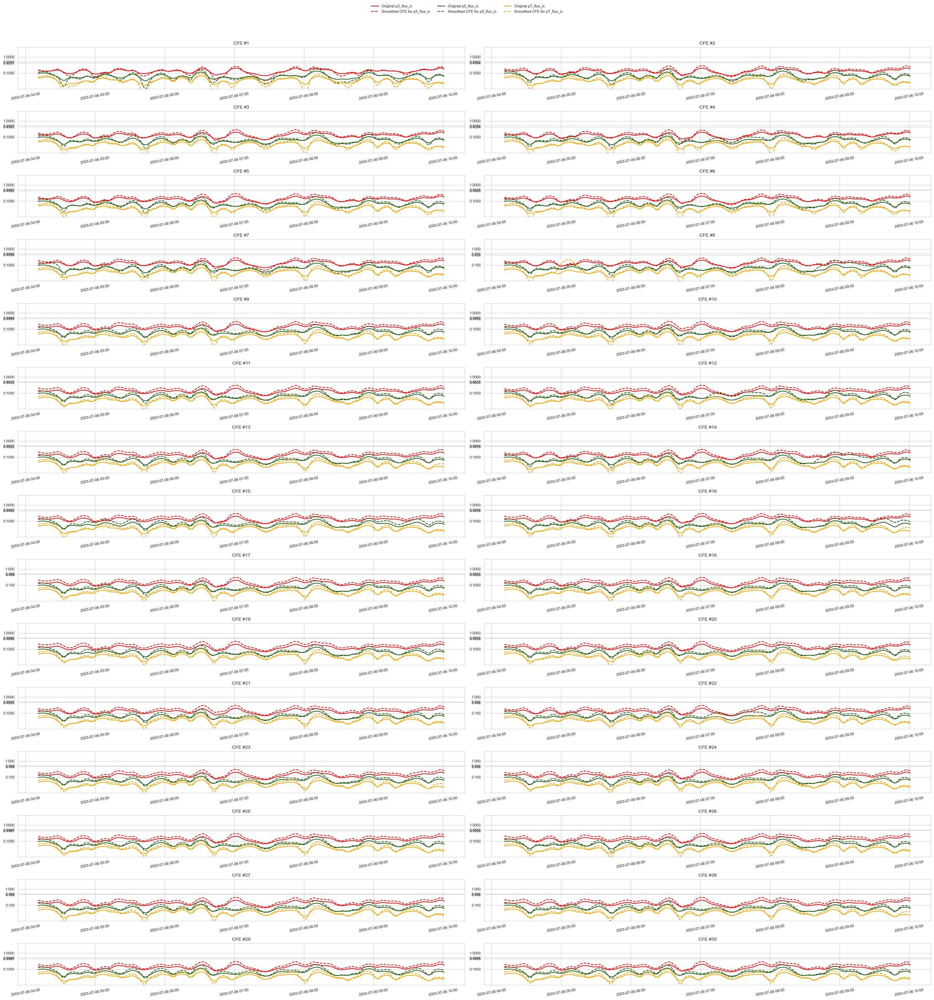

In [144]:
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.dates as mdates

window_size = 10  # Smoothing window

fig, axs = plt.subplots(15, 2, figsize=(28, 30), facecolor='white')
axs = axs.flatten()  # Flatten for easy iteration

for cfe_idx in range(30):
    sample_cfe = df_cfe_exp_genetic_6.iloc[cfe_idx]

    # p3
    flux_type = 'p3_flux_ic'
    df_obs, final_series_p3, original_p3, min_y_p3, max_y_p3 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p3_smooth = original_p3.rolling(window=window_size, center=True).mean()
    final_series_p3_smooth = pd.Series(final_series_p3).rolling(window=window_size, center=True).mean()

    # p5
    flux_type = 'p5_flux_ic'
    df_obs_1, final_series_p5, original_p5, min_y_p5, max_y_p5 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p5_smooth = original_p5.rolling(window=window_size, center=True).mean()
    final_series_p5_smooth = pd.Series(final_series_p5).rolling(window=window_size, center=True).mean()

    # p7
    flux_type = 'p7_flux_ic'
    df_obs_2, final_series_p7, original_p7, min_y_p7, max_y_p7 = get_pertubed_series(
        csv_path, sample_cfe=sample_cfe, flux_type=flux_type, slices=slices,
        start_offset_min=300, end_offset_min=660)
    original_p7_smooth = original_p7.rolling(window=window_size, center=True).mean()
    final_series_p7_smooth = pd.Series(final_series_p7).rolling(window=window_size, center=True).mean()

    global_max_y = max(max_y_p3, max_y_p5, max_y_p7)

    ax = axs[cfe_idx]
    ax.set_facecolor('white')

    # Plot lines
    ax.plot(df_obs['time_stamp'], original_p3_smooth, label="Original p3_flux_ic", color="#FF0000")
    ax.plot(df_obs['time_stamp'], final_series_p3_smooth, label="Smoothed CFE for p3_flux_ic", color="#FF0000", linestyle='dashed')
    ax.plot(df_obs_1['time_stamp'], original_p5_smooth, label="Original p5_flux_ic", color="#1b5c0c")
    ax.plot(df_obs_1['time_stamp'], final_series_p5_smooth, label="Smoothed CFE for p5_flux_ic", color="#1b5c0c", linestyle='dashed')
    ax.plot(df_obs_2['time_stamp'], original_p7_smooth, label="Original p7_flux_ic", color="#FFA500")
    ax.plot(df_obs_2['time_stamp'], final_series_p7_smooth, label="Smoothed CFE for p7_flux_ic", color="#FFA500", linestyle='dashed')
    #
    # ax.set_xlabel("Period of Observation", fontsize=9)
    # ax.set_ylabel("Particle Flux Unit (log scale)", fontsize=9)
    ax.set_yscale('log')
    ax.set_ylim(bottom=0.01, top=4)
    ax.set_yticks([0.1, 0.5, 1, global_max_y])
    ax.get_yaxis().set_major_formatter(plt.ScalarFormatter())
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
    plt.setp(ax.get_xticklabels(), rotation=10, ha='center', fontsize=8)
    plt.setp(ax.get_yticklabels(), fontsize=8)
    # if cfe_idx == 0:
    #     ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.15), ncol=3, frameon=False, fontsize=8)
    ax.set_title(f'CFE #{cfe_idx + 1}', fontsize=10)

handles, labels = axs[0].get_legend_handles_labels()
fig.legend(
    handles, labels,
    loc='upper center',
    bbox_to_anchor=(0.5, 0.995),  # Centered above the grid
    ncol=3,
    frameon=False,
    fontsize=8
)
plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the legend at the top
plt.show()



In [146]:
explainer.x1 = query_instance1
explainer = ConstrainedDiceGenetic(
    data_interface=data,
    model_interface=cfe_model,
    permitted_range_dict={},
    ordering_penalty=10,
    proximity_weight=10,
    sparsity_weight=1000,
    diversity_weight=1,
    class_means=class_means,
    class_covariances=class_covariances
)
# Generate counterfactuals
cf = explainer.generate_counterfactuals(
    query_instances=query_instance1,
    total_CFs=30,
    desired_class=1)
cfe_exp = []  # Initialize the list before the loop

cfe_df = cf.cf_examples_list[0].final_cfs_df
cfe_exp.append(cfe_df)  # Append each DataFrame

# Concatenate once after the loop
df_cfe_exp_genetic_6 = pd.concat(cfe_exp, ignore_index=True)
df_cfe_exp_genetic_6


100%|██████████| 1/1 [00:35<00:00, 35.50s/it]


p3_flux_ic_mean@[0:360]  p5_flux_ic_mean@[0:360]  p7_flux_ic_mean@[0:360]  \
0                  0.000000                     0.00                   0.0000   
1                  0.000000                     0.00                   0.0102   
2                  0.058025                     0.02                   0.0102   
3                  0.000000                     0.02                   0.0102   
4                  0.000000                     0.00                   0.0000   
5                  0.058025                     0.00                   0.0102   
6                  0.058025                     0.00                   0.0000   
7                  0.000000                     0.00                   0.0000   
8                  0.058025                     0.00                   0.0000   
9                  0.000000                     0.00                   0.0000   
10                 0.000000                     0.00                   0.0000   
11                 0.000000                     0.00                   0.0102   
12                 0.058025                     0.00                   0.0000   
13                 0.000000                     0.02                   0.0000   
14                 0.000000                     0.02                   0.0102   
15                 0.000000                     0.02                   0.0102   
16                 0.000000                     0.00                   0.0000   
17                 0.000000                     0.00                   0.0102   
18                 0.058025                     0.00                   0.0102   
19                 0.000000                     0.00                   0.0102   
20                 0.000000                     0.00                   0.0000   
21                 0.058025                     0.00                   0.0102   
22                 0.000000                     0.02                   0.0000   
23                 0.058025                     0.00                   0.0102   
24                 0.058025                     0.02                   0.0000   
25                 0.000000                     0.00                   0.0102   
26                 0.000000                     0.00                   0.0102   
27                 0.000000                     0.00                   0.0000   
28                 0.000000                     0.00                   0.0102   
29                 0.000000                     0.00                   0.0102   

    long_mean@[0:360]  p3_flux_ic_mean@[0:180]  p5_flux_ic_mean@[0:180]  \
0        0.000000e+00                  0.00000                    0.000   
1        0.000000e+00                  0.05369                    0.000   
2        1.007200e-07                  0.00000                    0.000   
3        1.007200e-07                  0.00000                    0.019   
4        1.007200e-07                  0.00000                    0.019   
5        1.007200e-07                  0.00000                    0.000   
6        1.007200e-07                  0.00000                    0.000   
7        0.000000e+00                  0.05369                    0.000   
8        0.000000e+00                  0.00000                    0.000   
9        0.000000e+00                  0.00000                    0.000   
10       0.000000e+00                  0.00000                    0.025   
11       1.007200e-07                  0.05369                    0.019   
12       1.007200e-07                  0.00000                    0.019   
13       1.007200e-07                  0.05369                    0.019   
14       0.000000e+00                  0.00000                    0.000   
15       0.000000e+00                  0.05369                    0.019   
16       1.007200e-07                  0.05369                    0.025   
17       0.000000e+00                  0.05369                    0.000   
18       0.000000e+00                  0.00000                    0

In [147]:
explainer.x1 = query_instance1
explainer = ConstrainedDiceGenetic(
    data_interface=data,
    model_interface=cfe_model,
    permitted_range_dict={},
    class_means=class_means,
    class_covariances=class_covariances
)
# Generate counterfactuals
cf = explainer.generate_counterfactuals(
    query_instances=query_instance1,
    total_CFs=30,
    desired_class=1)
cfe_exp = []  # Initialize the list before the loop

cfe_df = cf.cf_examples_list[0].final_cfs_df
cfe_exp.append(cfe_df)  # Append each DataFrame

# Concatenate once after the loop
df_cfe_exp_genetic_6 = pd.concat(cfe_exp, ignore_index=True)
df_cfe_exp_genetic_6


100%|██████████| 1/1 [00:37<00:00, 37.46s/it]


p3_flux_ic_mean@[0:360]  p5_flux_ic_mean@[0:360]  p7_flux_ic_mean@[0:360]  \
0                  0.000000                     0.00                   0.0000   
1                  0.000000                     0.00                   0.0102   
2                  0.058025                     0.00                   0.0102   
3                  0.058025                     0.02                   0.0102   
4                  0.000000                     0.02                   0.0000   
5                  0.000000                     0.00                   0.0000   
6                  0.000000                     0.00                   0.0000   
7                  0.000000                     0.00                   0.0102   
8                  0.058025                     0.02                   0.0102   
9                  0.000000                     0.00                   0.0000   
10                 0.000000                     0.00                   0.0102   
11                 0.000000                     0.02                   0.0102   
12                 0.000000                     0.00                   0.0000   
13                 0.000000                     0.00                   0.0102   
14                 0.000000                     0.00                   0.0102   
15                 0.000000                     0.02                   0.0102   
16                 0.058025                     0.02                   0.0102   
17                 0.000000                     0.00                   0.0102   
18                 0.000000                     0.02                   0.0000   
19                 0.000000                     0.00                   0.0000   
20                 0.058025                     0.00                   0.0000   
21                 0.000000                     0.00                   0.0102   
22                 0.058025                     0.02                   0.0102   
23                 0.058025                     0.00                   0.0102   
24                 0.058025                     0.02                   0.0000   
25                 0.000000                     0.00                   0.0102   
26                 0.000000                     0.00                   0.0000   
27                 0.000000                     0.00                   0.0102   
28                 0.058025                     0.02                   0.0000   
29                 0.058025                     0.02                   0.0000   

    long_mean@[0:360]  p3_flux_ic_mean@[0:180]  p5_flux_ic_mean@[0:180]  \
0        0.000000e+00                  0.00000                    0.000   
1        0.000000e+00                  0.00000                    0.000   
2        1.007200e-07                  0.00000                    0.000   
3        0.000000e+00                  0.05369                    0.000   
4        0.000000e+00                  0.05369                    0.000   
5        0.000000e+00                  0.00000                    0.019   
6        0.000000e+00                  0.00000                    0.000   
7        0.000000e+00                  0.05369                    0.019   
8        0.000000e+00                  0.05369                    0.019   
9        0.000000e+00                  0.05369                    0.019   
10       1.007200e-07                  0.00000                    0.000   
11       1.007200e-07                  0.05369                    0.019   
12       0.000000e+00                  0.05369                    0.019   
13       0.000000e+00                  0.00000                    0.000   
14       1.007200e-07                  0.05369                    0.019   
15       1.007200e-07                  0.05369                    0.019   
16       0.000000e+00                  0.00000                    0.019   
17       0.000000e+00                  0.05369                    0.019   
18       1.007200e-07                  0.05369                    0

Compare constrained and unconstrained Dice


In [ ]:
query_ts1_filename = '2003-07-05_23-06.csv'
query_instance1, target_val1,predicted_val= get_query_instance(query_ts1_filename, df_combined_labels=df_combined_labels, model=best_rf)
print(query_instance1)

In [30]:
Z=df_combined_labels.iloc[2127:2128] #2004-08-12_03-38.csv
X=Z.drop(["Label", "Event_Y_N", "Multi_Label", "File"],axis=1)
Y=Z['Event_Y_N']
y_pred=best_rf.predict(X)
y_pred

array([0], dtype=int64)

In [69]:
file_list=["2004-08-12_03-38.csv","2005-05-07_06-57.csv","2007-06-05_14-29.csv","2010-06-11_23-30.csv","2010-11-05_11-43.csv","2011-02-21_09-08.csv","2011-11-03_11-35.csv","2003-10-28_00-15.csv","2003-11-01_22-55.csv","2004-11-07_07-10.csv","2005-01-15_14-10.csv","2005-07-14_02-00.csv","2010-08-07_16-55.csv","2006-12-06_03-55.csv"]
filtered_df_for_CFE_generation = df_combined_labels[df_combined_labels["File"].isin(file_list)].reset_index(drop=True)
X_filtered=filtered_df_for_CFE_generation.drop(["Label", "Event_Y_N", "Multi_Label", "File"], axis=1)
Y_filtered=filtered_df_for_CFE_generation['Event_Y_N']
y_filtered_pred=best_rf.predict(X_filtered)
y_filtered_pred

array([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0], dtype=int64)

In [75]:
!pip install  dtaidistance


   ---------------------------------------- 0.0/1.0 MB ? eta -:--:--
   ---------------------------------------- 1.0/1.0 MB 10.0 MB/s eta 0:00:00


In [92]:
import numpy as np
import pandas as pd
import time
from tqdm import tqdm
from scipy.spatial.distance import euclidean
from dtaidistance import dtw # for DTW proximity

# ----------------------------
# 1. Setup
# ----------------------------

# Assume you have:
# - best_rf: trained RandomForest
# - exp: SCF explainer (DiCE-GA)
# - explainer: PBCF explainer (ConstrainedDiceGenetic)
# - query_instances: dataframe of test instances to evaluate

def dtw_distance(x, y):
    """Compute DTW distance between two numpy vectors."""
    d = dtw.distance(x, y)
    return d

def validity(cfs, clf, desired_class):
    """Fraction of CFs classified into desired class."""
    preds = clf.predict(cfs)
    return np.mean(preds == desired_class)

def sparsity(x_orig, x_cf):
    """Fraction of unchanged features (L0)."""
    return np.sum(x_orig != x_cf) / len(x_orig)

def diversity(cfs):
    """Average pairwise L2 distance among CFs."""
    if len(cfs) < 2:
        return 0
    dists = []
    for i in range(len(cfs)):
        for j in range(i+1, len(cfs)):
            dists.append(np.linalg.norm(cfs[i]-cfs[j]))
    return np.mean(dists)

def physics_residual(cfs, constraint_fn):
    """Compute average physics violation per CF (your function)."""
    return np.mean([constraint_fn(cf) for cf in cfs])

# ----------------------------
# 2. Experiment Loop
# ----------------------------

results = []

for idx, instance in tqdm(filtered_df_for_CFE_generation.iterrows(), total=len(filtered_df_for_CFE_generation)):

    x_orig = instance.drop(["Label", "Event_Y_N", "Multi_Label", "File"]).values.reshape(1, -1)

    for method_name, expl in [("exp_orig", exp_genetic), ("PBCF", explainer)]:
        start = time.time()

        # Generate CFs
        cf_obj = expl.generate_counterfactuals(
            query_instances=instance.drop(["Label", "Event_Y_N", "Multi_Label", "File"]).to_frame().T,
            total_CFs=5,          # k=5 CFs
            desired_class=1        # target class
        )

        end = time.time()

        # Extract CF array
        cfs = cf_obj.cf_examples_list[0].final_cfs_df.drop("Event_Y_N", axis=1).values

        if len(cfs) == 0:
            # no valid CFs found
            results.append({
                "instance_id": idx,
                "method": method_name,
                "validity": 0,
                "dtw": np.nan,
                "sparsity": np.nan,
                "diversity": np.nan,
                "physics_residual": np.nan,
                "runtime": end-start
            })
            continue

        # ---------------- Metrics ----------------
        val = validity(cfs, best_rf, desired_class=1)
        dtw_vals = [dtw_distance(x_orig.flatten(), cf) for cf in cfs]
        sparsity_vals = [sparsity(x_orig.flatten(), cf) for cf in cfs]
        div = diversity(cfs)
        phys = physics_residual(cfs, constraint_fn=lambda cf: 0)  # <-- replace with your physics check

        # Aggregate per instance
        results.append({
            "instance_id": idx,
            "method": method_name,
            "validity": val,
            "dtw": np.mean(dtw_vals),
            "sparsity": np.mean(sparsity_vals),
            "diversity": div,
            "physics_residual": phys,
            "runtime": end-start
        })

# ----------------------------
# 3. Results DataFrame
# ----------------------------
results_df = pd.DataFrame(results)

# Aggregate across all instances
summary = results_df.groupby("method").agg({
    "validity": ["mean", "std"],
    "dtw": ["mean", "std"],
    "sparsity": ["mean", "std"],
    "diversity": ["mean", "std"],
    "physics_residual": ["mean", "std"],
    "runtime": ["mean", "std"]
})

print(summary)


100%|██████████| 1/1 [00:03<00:00,  3.92s/it]

100%|██████████| 1/1 [00:03<00:00,  3.76s/it]

100%|██████████| 1/1 [00:04<00:00,  4.02s/it]

100%|██████████| 1/1 [00:04<00:00,  4.30s/it]

100%|██████████| 1/1 [00:03<00:00,  3.90s/it]

100%|██████████| 1/1 [00:03<00:00,  3.98s/it]

100%|██████████| 1/1 [00:03<00:00,  3.74s/it]

100%|██████████| 1/1 [00:03<00:00,  3.64s/it]

100%|██████████| 1/1 [00:03<00:00,  3.72s/it]

100%|██████████| 1/1 [00:03<00:00,  3.80s/it]

100%|██████████| 1/1 [00:03<00:00,  3.56s/it]

100%|██████████| 1/1 [00:03<00:00,  3.75s/it]

100%|██████████| 1/1 [00:03<00:00,  3.71s/it]

100%|██████████| 1/1 [00:03<00:00,  3.69s/it]

100%|██████████| 14/14 [03:56<00:00, 16.90s/it]

         validity               dtw               sparsity            \
             mean  std         mean          std      mean       std   
method                                                                 
PBCF          1.0  0.0  1082.739182  3218.059676  0.999954  0.000125   
exp_orig      1.0  0.0   966.544140  2780.334468  0.985653  0.017685   

           diversity              physics_residual        runtime            
                mean          std             mean  std      mean       std  
method                                                                       
PBCF      280.589263   619.637508              0.0  0.0  3.634030  0.183832  
exp_orig  510.484567  1417.130130              0.0  0.0  3.875641  0.193705  


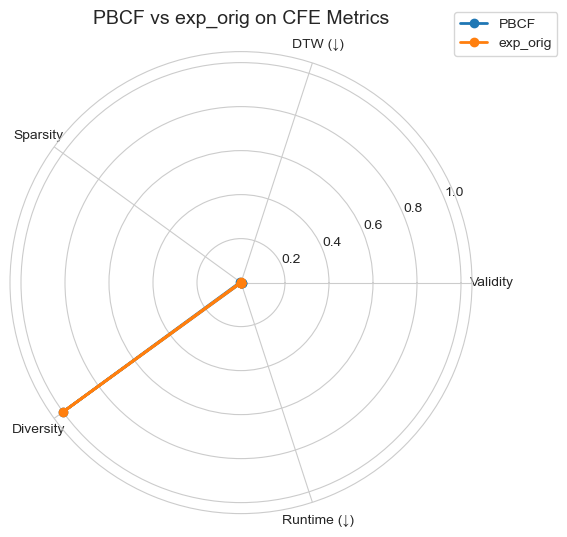

In [93]:
import matplotlib.pyplot as plt
import numpy as np

# Metrics from your table
metrics = ["Validity", "DTW (↓)", "Sparsity", "Diversity", "Runtime (↓)"]
pbcf_vals = [1.0, 1082.74, 0.99995, 280.59, 3.63]
exp_vals  = [1.0, 966.54, 0.98565, 510.48, 3.88]

# For DTW and Runtime, smaller is better → invert them
invert_idx = [1, 4]  # indexes of DTW and Runtime

def normalize(values, invert_idx):
    normed = []
    for i, v in enumerate(values):
        if i in invert_idx:   # invert "smaller is better"
            v = 1 / v
        normed.append(v)
    normed = np.array(normed)
    return normed / normed.max()  # scale 0–1

pbcf_norm = normalize(pbcf_vals, invert_idx)
exp_norm = normalize(exp_vals, invert_idx)

# Radar chart setup
labels = np.array(metrics)
angles = np.linspace(0, 2*np.pi, len(labels), endpoint=False).tolist()
angles += angles[:1]  # close loop

# Values (close loop by appending first val)
pbcf_plot = np.concatenate((pbcf_norm, [pbcf_norm[0]]))
exp_plot = np.concatenate((exp_norm, [exp_norm[0]]))

# Plot
fig, ax = plt.subplots(figsize=(6,6), subplot_kw=dict(polar=True))

ax.plot(angles, pbcf_plot, 'o-', linewidth=2, label="PBCF")
ax.fill(angles, pbcf_plot, alpha=0.25)

ax.plot(angles, exp_plot, 'o-', linewidth=2, label="exp_orig")
ax.fill(angles, exp_plot, alpha=0.25)

ax.set_thetagrids(np.degrees(angles[:-1]), labels)
ax.set_title("PBCF vs exp_orig on CFE Metrics", size=14, pad=20)
ax.legend(loc='upper right', bbox_to_anchor=(1.2, 1.1))

plt.show()


In [95]:
import numpy as np
import pandas as pd
import time
from tqdm import tqdm
from scipy.spatial.distance import euclidean
from dtaidistance import dtw # for DTW proximity

# ----------------------------
# 1. Setup
# ----------------------------

# Assume you have:
# - best_rf: trained RandomForest
# - exp: SCF explainer (DiCE-GA)
# - explainer: PBCF explainer (ConstrainedDiceGenetic)
# - query_instances: dataframe of test instances to evaluate

def dtw_distance(x, y):
    """Compute DTW distance between two numpy vectors."""
    d = dtw.distance(x, y)
    return d

def validity(cfs, clf, desired_class):
    """Fraction of CFs classified into desired class."""
    preds = clf.predict(cfs)
    return np.mean(preds == desired_class)

def sparsity(x_orig, x_cf):
    """Fraction of unchanged features (L0)."""
    return np.sum(x_orig != x_cf) / len(x_orig)

def diversity(cfs):
    """Average pairwise L2 distance among CFs."""
    if len(cfs) < 2:
        return 0
    dists = []
    for i in range(len(cfs)):
        for j in range(i+1, len(cfs)):
            dists.append(np.linalg.norm(cfs[i]-cfs[j]))
    return np.mean(dists)

def physics_residual(cfs, constraint_fn):
    """Compute average physics violation per CF (your function)."""
    return np.mean([constraint_fn(cf) for cf in cfs])

# ----------------------------
# 2. Experiment Loop
# ----------------------------

results = []
df_test_SEP_post_2003=df_combined_labels.iloc[1970:]
df_random_50 = df_test_SEP_post_2003.sample(n=50, random_state=42).sort_index()
for idx, instance in tqdm(df_random_50.iterrows(), total=len(df_random_50)):

    x_orig = instance.drop(["Label", "Event_Y_N", "Multi_Label", "File"]).values.reshape(1, -1)

    for method_name, expl in [("exp_orig", exp_genetic), ("PBCF", explainer)]:
        start = time.time()

        # Generate CFs
        cf_obj = expl.generate_counterfactuals(
            query_instances=instance.drop(["Label", "Event_Y_N", "Multi_Label", "File"]).to_frame().T,
            total_CFs=5,          # k=5 CFs
            desired_class=1        # target class
        )

        end = time.time()

        # Extract CF array
        cfs = cf_obj.cf_examples_list[0].final_cfs_df.drop("Event_Y_N", axis=1).values

        if len(cfs) == 0:
            # no valid CFs found
            results.append({
                "instance_id": idx,
                "method": method_name,
                "validity": 0,
                "dtw": np.nan,
                "sparsity": np.nan,
                "diversity": np.nan,
                "physics_residual": np.nan,
                "runtime": end-start
            })
            continue

        # ---------------- Metrics ----------------
        val = validity(cfs, best_rf, desired_class=1)
        dtw_vals = [dtw_distance(x_orig.flatten(), cf) for cf in cfs]
        sparsity_vals = [sparsity(x_orig.flatten(), cf) for cf in cfs]
        div = diversity(cfs)
        phys = physics_residual(cfs, constraint_fn=lambda cf: 0)  # <-- replace with your physics check

        # Aggregate per instance
        results.append({
            "instance_id": idx,
            "method": method_name,
            "validity": val,
            "dtw": np.mean(dtw_vals),
            "sparsity": np.mean(sparsity_vals),
            "diversity": div,
            "physics_residual": phys,
            "runtime": end-start
        })

# ----------------------------
# 3. Results DataFrame
# ----------------------------
results_df = pd.DataFrame(results)

# Aggregate across all instances
summary = results_df.groupby("method").agg({
    "validity": ["mean", "std"],
    "dtw": ["mean", "std"],
    "sparsity": ["mean", "std"],
    "diversity": ["mean", "std"],
    "physics_residual": ["mean", "std"],
    "runtime": ["mean", "std"]
})

print(summary)


100%|██████████| 1/1 [00:03<00:00,  3.60s/it]

100%|██████████| 1/1 [00:03<00:00,  3.48s/it]

100%|██████████| 1/1 [00:03<00:00,  3.96s/it]

100%|██████████| 1/1 [00:03<00:00,  3.92s/it]

100%|██████████| 1/1 [00:03<00:00,  3.41s/it]

100%|██████████| 1/1 [00:03<00:00,  3.42s/it]

100%|██████████| 1/1 [00:03<00:00,  3.81s/it]

100%|██████████| 1/1 [00:03<00:00,  3.33s/it]

100%|██████████| 1/1 [00:03<00:00,  3.36s/it]

100%|██████████| 1/1 [00:03<00:00,  3.36s/it]

100%|██████████| 1/1 [00:03<00:00,  3.82s/it]

100%|██████████| 1/1 [00:03<00:00,  3.36s/it]

100%|██████████| 1/1 [00:03<00:00,  3.39s/it]

100%|██████████| 1/1 [00:03<00:00,  3.38s/it]

100%|██████████| 1/1 [00:03<00:00,  3.83s/it]

100%|██████████| 1/1 [00:03<00:00,  3.39s/it]

100%|██████████| 1/1 [00:03<00:00,  3.63s/it]

100%|██████████| 1/1 [00:04<00:00,  4.20s/it]

100%|██████████| 1/1 [01:22<00:00, 82.44s/it]

100%|██████████| 1/1 [00:03<00:00,  3.88s/it]

100%|██████████| 1/1 [00:03<00:00,  3.77s/it]

100%|████████

         validity                 dtw            sparsity            \
             mean      std       mean       std      mean       std   
method                                                                
PBCF        0.992  0.03959   4.419462  5.821925  0.999961  0.000161   
exp_orig    1.000  0.00000  27.932400  8.887617  0.997611  0.007328   

          diversity           physics_residual        runtime             
               mean       std             mean  std      mean        std  
method                                                                    
PBCF       5.492998  7.016042              0.0  0.0  3.619628   0.290925  
exp_orig  23.489662  4.404974              0.0  0.0  6.986889  15.751904  


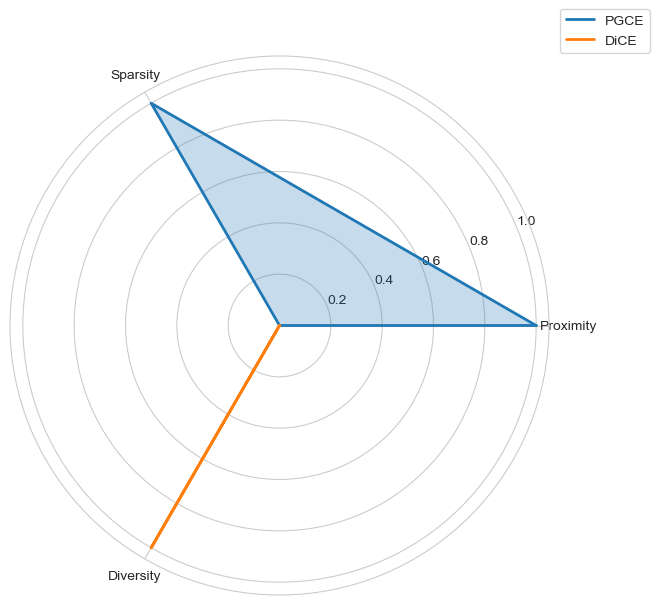

In [103]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler

# Your results (mean values only)
data = {
    "Proximity": {"PGCE": 4.419462, "DiCE": 27.932400},          # lower = better
    "Sparsity": {"PGCE": 0.999961, "DiCE": 0.997611},
    "Diversity": {"PGCE": 5.492998, "DiCE": 23.489662}
    # "Runtime": {"PBCF": 3.619628, "exp_orig": 6.986889}        # lower = better
}

df = pd.DataFrame(data)

# Invert metrics where "lower is better"
df_inverted = df.copy()
df_inverted["Proximity"] = -df_inverted["Proximity"]
# df_inverted["runtime"] = -df_inverted["runtime"]

# Normalize (0–1) so they’re comparable
scaler = MinMaxScaler()
df_scaled = pd.DataFrame(
    scaler.fit_transform(df_inverted),
    index=df.index,
    columns=df.columns
)

# Radar plot setup
categories = df_scaled.columns.tolist()
N = len(categories)
angles = np.linspace(0, 2*np.pi, N, endpoint=False).tolist()
angles += angles[:1]

fig, ax = plt.subplots(figsize=(7, 7), subplot_kw=dict(polar=True))

for method in df_scaled.index:
    values = df_scaled.loc[method].tolist()
    values += values[:1]
    ax.plot(angles, values, label=method, linewidth=2)
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(categories)
ax.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
# ax.set_title("Radar Plot (Higher = Better on All Metrics)", size=14)
ax.legend(loc="upper right", bbox_to_anchor=(1.2, 1.1))
plt.show()
